# Dimensionality Reduction

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib_inline.backend_inline
import seaborn as sns

from sklearn.tree import DecisionTreeClassifier as DTC
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
# from sklearn.dummy import DummyClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, classification_report, \
    accuracy_score, precision_score, recall_score
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import RFE, RFECV, SelectKBest, f_classif, mutual_info_classif
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE, Isomap
from sklearn import tree

from itertools import accumulate
import pickle


import warnings # ignore FutureWarning TSNE
warnings.filterwarnings("ignore")

In [2]:
matplotlib_inline.backend_inline.set_matplotlib_formats('png', 'pdf')
plt.rcParams.update({'font.size': 12,
                     'xtick.labelsize' : 12,
                     'ytick.labelsize' : 12,
                     'axes.grid': False})

my_colors = plt.rcParams['axes.prop_cycle'].by_key()['color'] 

In [161]:
def plot_scatter(X: 'reduced dataset', y: 'target variable', 
                 class_names: dict = None, figsize = (6, 4)):
    '''
    class_names: dict mapping class numbers (y) to class names
    '''
    fig, ax = plt.subplots(figsize = figsize)
    scatter = ax.scatter(X[:, 0], X[:, 1], c = y, edgecolor = 'k', lw = 0.5)
    handles, labels = scatter.legend_elements()
    if class_names is not None:
        # each item in labels has the format '$\\mathdefault{number}$'
        keys = [int(''.join(filter(str.isdigit, string))) for string in labels] 
        labels = [class_names[i] for i in keys]
    ax.legend(handles, labels, loc = 'lower center', ncol = 2, 
              fontsize = 'small', bbox_to_anchor = (0, 1, 1, 1))    
    ax.set_xlabel('1st Component', fontsize = 14)
    ax.set_ylabel('2nd Component', fontsize = 14)
    ax.set_xticks([]) 
    ax.set_yticks([])

In [178]:
def plot_scatter3d(X: 'reduced dataset', y: 'target variable', 
                   class_names: dict = None, figsize = (10, 6)):
    '''
    class_names: dict mapping class numbers (y) to class names
    '''    
    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot(projection = '3d')
    scatter = ax.scatter3D(X[:, 0], X[:, 1], X[:, 2], c = y, 
                           edgecolor = 'k', s = 40, lw = 0.4)  
    handles, labels = scatter.legend_elements()
    if class_names is not None:
        # each item in labels has the format '$\\mathdefault{number}$'
        keys = [int(''.join(filter(str.isdigit, string))) for string in labels] 
        labels = [class_names[i] for i in keys]       
    # set legend
    plt.legend(handles, labels, loc = 'center left', 
               bbox_to_anchor = (1.02, 0.5), borderaxespad = 0, fontsize = 'small')      
    ax.set_xlabel('1st Component', fontsize = 14)
    ax.set_ylabel('2nd Component', fontsize = 14)
    ax.set_zlabel('3rd Component', fontsize = 14)
    # remove ticks 
    ax.set_xticks(ax.get_xticks(), []) 
    ax.set_yticks(ax.get_yticks(), []) 
    ax.set_zticks(ax.get_zticks(), [])
    # move labels close to the axis
    ax.xaxis.labelpad = -11
    ax.yaxis.labelpad = -12
    ax.zaxis.labelpad = -12     
    # plt.tight_layout() non funziona qui
    fig.subplots_adjust(left=0, right=1, bottom=0, top=1)
    bbox = fig.bbox_inches.from_bounds(1.15, 3.57, 3.70, -3.35) #(left,top,right,bottom)

In [8]:
def eta_squared(X, y):
    if isinstance(X, type(np.array([]))):
        X = pd.DataFrame(X)
    if isinstance(y, type(np.array([]))):
        y = pd.DataFrame(y)    
    df = pd.concat((X, y), axis = 1, ignore_index = True)
    varibles = df.columns[:-1]
    target = df.columns[-1]
    variances = df[varibles].var(ddof = 0)
    means = df[varibles].mean()
    g = df.groupby(target)
    g_sizes = g.size()
    g_means = g.mean()
    var_g_means = (((g_means - means)**2).mul(g_sizes, axis=0)).sum() / df.shape[0]
    eta = var_g_means / variances
    return eta

In [9]:
def F_test(X, y):
    if isinstance(X, type(np.array([]))):
        X = pd.DataFrame(X)
    if isinstance(y, type(np.array([]))):
        y = pd.DataFrame(y)   
    n_classes = np.unique(y_train).size
    df = pd.concat((X, y), axis = 1, ignore_index = True)
    varibles = df.columns[:-1]
    target = df.columns[-1]
    means = df[varibles].mean()
    g = df.groupby(target)
    g_sizes = g.size()
    g_means = g.mean()
    g_variances = g.var(ddof = 0)
    expl_vars = (((g_means - means) ** 2).mul(g_sizes, axis = 0)).sum() / (n_classes - 1)
    unexpl_vars = ((g_variances.mul(g_sizes, axis = 0)) / (df.shape[0] - n_classes)).sum()
    return expl_vars / unexpl_vars

In [10]:
# Credits to prof. R. Guidotti

def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")

In [11]:
def plot_confusion_mtx(cm: 'confusion matrix', labels = None, 
                       figsize = (3,3), binary = True):
    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot()
    sns.heatmap(cm, annot = True, fmt = '0', annot_kws = {"fontsize": 16}, 
                cmap = "Blues", cbar = False, ax = ax)
    ax.set_xlabel('Predicted Class', fontsize = 14)
    ax.set_ylabel('Actual Class', fontsize = 14)
    if labels is None:
        labels = range(1, cm.shape[1] + 1)     
    ax.set_xticks(ax.get_xticks(), labels)
    ax.set_yticks(ax.get_yticks(), labels)
    if binary:
        ax.set_xticks([0.5,1.5], [r'+', r'$-$'], fontsize = 18)
        ax.set_yticks([0.5,1.5], [r'+', r'$-$'], fontsize = 18)
        ax.xaxis.tick_top()
        ax.xaxis.set_label_position('top')

In [12]:
def plot_decision_boundaries(X, classes, clf, 
                             class_names: dict = None, figsize = (6, 4)):
    '''
    classes: array-like containing numerical classes
    clf: the trained classifier
    class_names: dict mapping class numbers to class names    
    '''
    
    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot()    
    x_min, y_min = X.min(axis = 0) - 1
    x_max, y_max = X.max(axis = 0) + 1
    '''
    artificial generated points evenly spaced within the region 
    delimitated by our data. x_grid and y_grid are matrices 
    containing x and y coordinates respectively.
    '''
    x_grid, y_grid = np.meshgrid(np.linspace(x_min, x_max, 1000), 
                                 np.linspace(y_min, y_max, 1000))   
    # put together x and y coordinates to build a matrix of (x,y) points
    xy_coordinates = np.vstack((x_grid.ravel(), y_grid.ravel())).T  
    # predictions of the artificial points
    pred = clf.predict(xy_coordinates) # 1d array with size=100_000  
    # Plot decision boundary and scatter plot
    contourf = ax.contourf(x_grid, y_grid, pred.reshape(1000, 1000), alpha = 0.6)    
    scatter = ax.scatter(X[:, 0], X[:, 1], c = classes, edgecolor = 'k')
    handles, labels = scatter.legend_elements()
    if class_names is not None:
        # each item in labels has the format '$\\mathdefault{number}$'
        keys = [int(''.join(filter(str.isdigit, string))) for string in labels] 
        labels = [class_names[i] for i in keys]
    ax.legend(handles, labels, loc = 'lower center', ncol = 2, 
              fontsize = 'small', bbox_to_anchor = (0, 1, 1, 1)) 
    ax.set_xlabel('1st Component', fontsize = 14)
    ax.set_ylabel('2nd Component', fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])

In [13]:
def plot_features_cv(cv_model, figsize = (6,4)):
    '''
    cv_model: : cross validation model. It must have the 
    cv_results_ attribute.
    '''
    plt.figure(figsize = figsize, tight_layout = 'True')
    acc_means = cv_model.cv_results_['mean_test_score']
    acc_stds = cv_model.cv_results_['std_test_score']
    x_range = range(1, len(acc_means) + 1)
    plt.plot(x_range, acc_means)
    plt.fill_between(x_range, acc_means - acc_stds, acc_means + acc_stds, alpha = 0.2)
    plt.xlabel('Features', fontsize = 14)
    plt.ylabel('Accuracy', fontsize = 14)

In [14]:
def variance(X, y):
    '''
    The function computes the variance of each feature of X. 
    y has no purpose in this function. It was included because we needed 
    a 2nd argument to pass the function as an argument of SelectKBest.
    '''
    if isinstance(X, type(np.array([]))):
        X = pd.DataFrame(X) 
    return X.var()

---

## Load Data

In [7]:
X_train = pd.read_fwf(".\X_train.txt", header = None)
X_test = pd.read_fwf(".\X_test.txt", header = None)
y_train = pd.read_fwf(".\y_train.txt", header = None) # df, not a series
y_test = pd.read_fwf(".\y_test.txt", header = None) # df, not a series

In [ ]:
with open("features.txt") as f:
    lines = f.read().splitlines() 

In [ ]:
features = {}
for line in lines:
    idx, name = line.split()
    features[int(idx)-1] = name

In [ ]:
with open('activity_labels.txt') as f:
    lines = f.read().splitlines()

activities = {}
for line in lines:
    label, activity = line.split()
    activities[int(label)] = activity

---

## Feature selection

Both filter and embedded strategies are computationally expensive. To speed up the search of the best features, we first perform a preprocessing step: we run the decision tree alone to detect the attributes that are never used during the tree construction procedure and remove them from the set of features.

In [49]:
cls = DTC(random_state = 5).fit(X_train, y_train)

In [50]:
print(' tree depth =', cls.get_depth(), '\n',
      'number of leaves = ', cls.get_n_leaves())

 tree depth = 18 
 number of leaves =  163


In [51]:
activities

{1: 'WALKING',
 2: 'WALKING_UPSTAIRS',
 3: 'WALKING_DOWNSTAIRS',
 4: 'SITTING',
 5: 'STANDING',
 6: 'LAYING'}

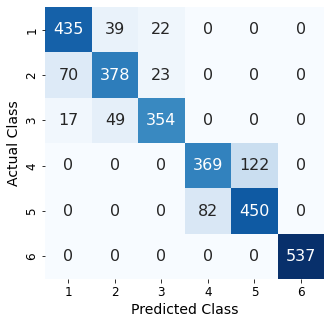

In [52]:
predictions = cls.predict(X_test)
cm = confusion_matrix(y_test, predictions)
plot_confusion_mtx(cm, binary = False, figsize=(5,5))

In [53]:
print(classification_report(y_test, predictions, 
      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.83      0.88      0.85       496
  WALKING_UPSTAIRS       0.81      0.80      0.81       471
WALKING_DOWNSTAIRS       0.89      0.84      0.86       420
           SITTING       0.82      0.75      0.78       491
          STANDING       0.79      0.85      0.82       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.86      2947
         macro avg       0.86      0.85      0.85      2947
      weighted avg       0.86      0.86      0.86      2947



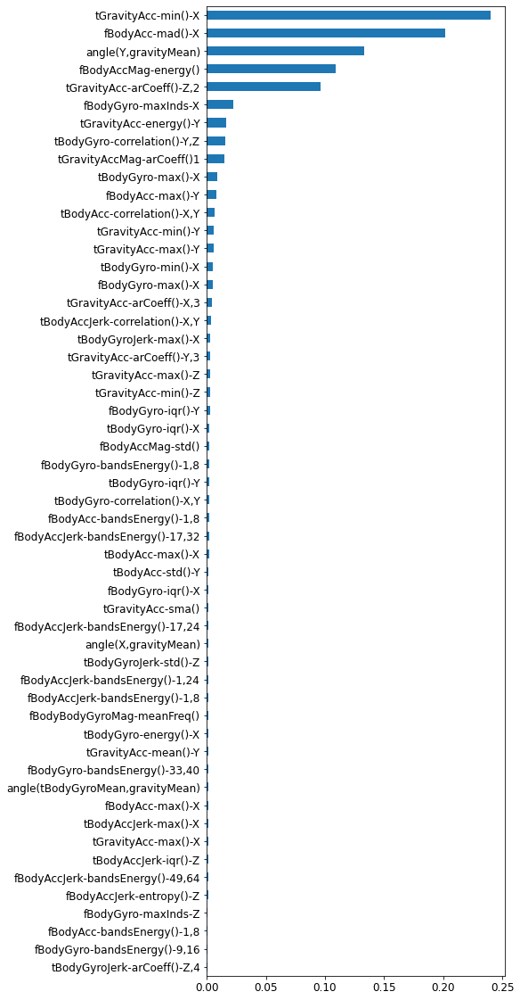

In [54]:
# let's show the features with the large importance (feature importance > 0.1%)

cls_series = pd.Series(cls.feature_importances_, index = features.keys())
mask = cls_series > 0.001 
dtc_best_attr = X_train.columns[mask]
cls_series = cls_series[mask].sort_values()
sorted_attr = cls_series.index
sorted_attr_named = [features[i] for i in sorted_attr]
cls_series.index = sorted_attr_named

plt.figure(figsize=(6,20))
cls_series.plot.barh()
plt.show()

In [55]:
# number of feature selected

len(dtc_best_attr)

54

In [56]:
mask = np.where(cls.feature_importances_ == 0)
not_used_attr = X_train.columns[mask]

f'There are {len(not_used_attr)} attributes that were never \
used during the training procedure'

'There are 430 attributes that were never used during the training procedure'

In [1]:
# for col in not_used_attr:
#     print(features[col])

In [58]:
best_features = np.where(cls.feature_importances_ > 0)[0]
best_features.size

131

`best_features` is the set of features that we will use from here on in order to speed up the computation.

---

### Embedded Stategy

We apply the Embedded Stategy using the RFECV algorithm, that is the RFE with cross-validation.

It works in this way: initially, the estimator is trained on the whole set of features (131) and the least important attributes are discarded. The 	usefulness of a feature is measured with respect to its coefficient or its feature importance. Then the procedure is repeated on the remaining set of variables. The number of features to remove at each iteration is a hyperparameter (`steps`), and different values might produce different results. By default, it is equal to one, meaning that at each iteration it removes exactly one attribute. At each iteration we measure the accuracy of the model. In the end we select the set of feature that produced the highest accuracy.

In [ ]:
# DTC

In [197]:
rfecv_dtc = RFECV(DTC(random_state = 5), cv = 5,
              scoring = "accuracy", n_jobs = -1)

In [198]:
# again, in order to speed up the algorithm we start with the set of 
# feature with a positive importance selected by the plain DTC

rfecv_dtc.fit(X_train[best_features].values, y_train[0].values)

RFECV(cv=5, estimator=DecisionTreeClassifier(random_state=5), n_jobs=-1,
      scoring='accuracy')

In [1]:
# rfecv_dtc.cv_results_

In [200]:
# number of selected features

rfecv_dtc.n_features_

19

The cross-validation RFE selects 19 features out of 131

In [407]:
rfecv_dtc_best_features = best_features[rfecv_dtc.support_]

In [227]:
# maximum accuracy reached

rfecv_dtc.cv_results_['mean_test_score'].max()

0.8681997068031835

In [408]:
rfecv_dtc_best_features

array([ 37,  50,  52,  54,  57,  67,  74, 117, 129, 132, 139, 159, 222,
       275, 393, 443, 448, 508, 559], dtype=int64)

In [202]:
# selected features

for attr in rfecv_dtc_best_features:
    print(features[attr])

tBodyAcc-correlation()-X,Y
tGravityAcc-max()-Y
tGravityAcc-min()-X
tGravityAcc-min()-Z
tGravityAcc-energy()-Y
tGravityAcc-arCoeff()-X,3
tGravityAcc-arCoeff()-Z,2
tBodyAccJerk-correlation()-X,Y
tBodyGyro-max()-X
tBodyGyro-min()-X
tBodyGyro-iqr()-X
tBodyGyro-correlation()-Y,Z
tGravityAccMag-arCoeff()1
fBodyAcc-max()-Y
fBodyAccJerk-bandsEnergy()-1,24
fBodyGyro-iqr()-Y
fBodyGyro-maxInds-X
fBodyAccMag-energy()
angle(Y,gravityMean)


Maybe we can enlarge the set of selected features including the attributes with a high ranking

In [242]:
# Best features (i.e. the ones selected) have score 1

rfecv_dtc.ranking_

array([ 17,  14,  74,  69,  70,  62,   1,  65,  72,  82,  10,   1,  63,
         1,   8,   1,  27,   1,  61,   1,   2, 100,   1,  83,  76,  64,
        18,  30,  58,  44,  35,  52, 111,   1,  22, 107,   1,   1,  39,
         1,   7,  43, 112,  11,  41,   1,   9,  55,   6,  56,  84,  86,
        36,  91,  90,  94,  20,  53, 102,  87,   1,  32, 109,  42,   4,
       113,  37,  51,  79,  71,  92,  99,   1,  34,  50,  60,  75,  31,
        13,  88,  78,  33,  57,  95,  19,  81,  93,  49, 101,  77,  89,
        80,  46,  40,  98,  68, 103,   1,  97,  21,  45, 110,  15,  25,
       106,  28, 108, 104,   1,  85,   1,  47,  16,  73,  38,  59,  24,
        67,   5, 105,  29,  66,   3,  54,   1,  96,  48,  12,  23,  26,
         1])

In [232]:
dtc_ranking = pd.Series(rfecv_dtc.ranking_, index = best_features)

In [250]:
# let's group scores in a fixed number of equal width bins 

n_bins = 10
dtc_ranking.value_counts(bins = n_bins).sort_index()

(0.887, 12.2]     30
(12.2, 23.4]      11
(23.4, 34.6]      11
(34.6, 45.8]      11
(45.8, 57.0]      12
(57.0, 68.2]      11
(68.2, 79.4]      11
(79.4, 90.6]      11
(90.6, 101.8]     11
(101.8, 113.0]    12
dtype: int64

In [245]:
dtc_ranking[(dtc_ranking > 1) & (dtc_ranking < 11)].sort_values()

71      2
503     3
236     4
470     5
169     6
140     7
53      8
165     9
49     10
dtype: int32

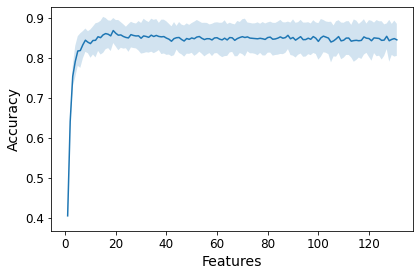

In [272]:
plot_features_cv(rfecv_dtc)

In [206]:
dtc = DTC(random_state = 5).fit(X_train[rfecv_dtc_best_features], y_train)
dtc_pred = dtc.predict(X_test[rfecv_dtc_best_features])

In [207]:
print(classification_report(y_test, dtc_pred, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.82      0.89      0.85       496
  WALKING_UPSTAIRS       0.78      0.76      0.77       471
WALKING_DOWNSTAIRS       0.88      0.81      0.85       420
           SITTING       0.83      0.76      0.79       491
          STANDING       0.79      0.86      0.83       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.85      2947
         macro avg       0.85      0.85      0.85      2947
      weighted avg       0.85      0.85      0.85      2947



These scores are almost the same as those of the simple DTC. Perhaps the only notable difference is the 4% less Recall of the WALKING UPSTAIRS class.

Let's see whether the weighted f1 score produces different results.

In [95]:
rfecv2_dtc = RFECV(DTC(random_state = 5), cv = 5,
              scoring = "f1_weighted", n_jobs = -1)

In [96]:
rfecv2_dtc.fit(X_train[best_features].values, y_train[0].values)

RFECV(cv=5, estimator=DecisionTreeClassifier(random_state=5), n_jobs=-1,
      scoring='f1_weighted')

In [97]:
rfecv2_dtc.n_features_

19

In [100]:
np.all((rfecv_dtc.support_ == rfecv2_dtc.support_))

True

The cross-validation with the weighted f1 score  selects the same features

---

Let's see what happens if we use other estimators, like for example the LinearSVC classifier or the Logistic Regressor Classifier. 

We can't use KNN because the RFECV algorithm requires the chosen estimator have the `coef_` or `feature_importances_` attribute. In fact, we could use the KNN with another approach, which is the Sequential Feature Selection (SFS). However, it is not feasible with our dataset. Indeed, since it does not include a measure to compute the importance of the features, at each step, in order to remove one attribute and then pass from $n$ to $n-1$ features, the SFS needs to run the algorithm with each possible combination and thus $n$ times (without considering the cross-validation). This is what is called the WRAPPER approach. Unfortunately, the time complexity with 561 features is prohibitive. [1]

[1] https://scikit-learn.org/stable/modules/feature_selection.html#sequential-feature-selection

In [ ]:
# LinearSVC

In [138]:
rfecv_svc = RFECV(LinearSVC(random_state = 5), cv = 5,
              scoring = "accuracy", n_jobs = -1)

In [139]:
rfecv_svc.fit(X_train[best_features].values, y_train[0].values)

RFECV(cv=5, estimator=LinearSVC(random_state=5), n_jobs=-1, scoring='accuracy')

In [143]:
rfecv_svc.n_features_

96

In [225]:
rfecv_svc.cv_results_['mean_test_score'].max()

0.9204350781781102

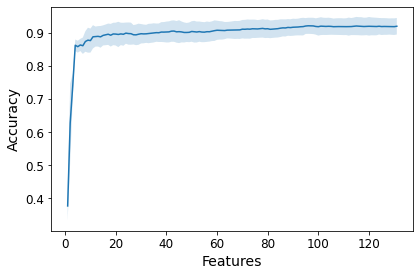

In [271]:
plot_features_cv(rfecv_svc)

Note: the order through which the DTC and LinearSVC classifiers eliminate features might not be the same.

In [145]:
best_svc_features = best_features[rfecv_svc.support_]

In [149]:
best_svc = LinearSVC(random_state = 5)
best_svc.fit(X_train[best_svc_features], y_train)
best_svc_pred = best_svc.predict(X_test[best_svc_features])

In [150]:
print(classification_report(y_test, best_svc_pred, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.93      1.00      0.96       496
  WALKING_UPSTAIRS       0.96      0.92      0.94       471
WALKING_DOWNSTAIRS       1.00      0.96      0.98       420
           SITTING       0.88      0.79      0.83       491
          STANDING       0.83      0.89      0.86       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.93      2947
         macro avg       0.93      0.93      0.93      2947
      weighted avg       0.93      0.93      0.93      2947



Let's use the best features selected in the RFECV with DTC to run the linearSVC classifier.

In [151]:
svc2 = LinearSVC(random_state = 5).fit(X_train[rfecv_dtc_best_features], y_train)
svc2_pred = svc2.predict(X_test[rfecv_dtc_best_features])

In [152]:
print(classification_report(y_test, svc2_pred, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.82      0.96      0.89       496
  WALKING_UPSTAIRS       0.90      0.80      0.84       471
WALKING_DOWNSTAIRS       0.95      0.89      0.92       420
           SITTING       0.85      0.77      0.81       491
          STANDING       0.79      0.86      0.82       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.88      2947
         macro avg       0.89      0.88      0.88      2947
      weighted avg       0.88      0.88      0.88      2947



Using the best features selected for the DTC with the LinearSVC leads to a drop in prediction power of about 5%.

Note: the scores obtained with the RFECV algorithm are computed on the Train set because they are obteined during cross-validation. For this reason, in order to perform this test in the same conditions, we evaluate the accuracy by cross-validation.

In [532]:
svc_cvscores = cross_val_score(LinearSVC(random_state = 5), 
                               X_train[rfecv_dtc_best_features], y_train, 
                               cv = 5, n_jobs = -1)

In [540]:
print(f'Mean score = {svc_cvscores.mean():.3} +/- {svc_cvscores.std():.2}')

Mean score = 0.896 +/- 0.034


Of course, we obtained a higher score over the train set due to overfitting, but now we can directly compare the score reached by LinearSVC with its 96 best features with the score obtained by LinearSVC with the 19 features selected by the RFECV DTC. The difference in accuracy obtained using 19 features instead of 96 is just about 2.5%

In [544]:
rfecv_svc.cv_results_['mean_test_score'].max() - svc_cvscores.mean()

0.02475792764420537

---

In [ ]:
# Logistic Regression

In [159]:
rfecv_logit = RFECV(LogisticRegression(random_state = 5), 
                    cv = 5, scoring = "accuracy", n_jobs = -1)

In [160]:
rfecv_logit.fit(X_train[best_features].values, y_train[0].values)

RFECV(cv=5, estimator=LogisticRegression(n_jobs=-1, random_state=5), n_jobs=-1,
      scoring='accuracy')

In [161]:
rfecv_logit.n_features_

96

In [224]:
rfecv_logit.cv_results_['mean_test_score'].max()

0.9209784634452014

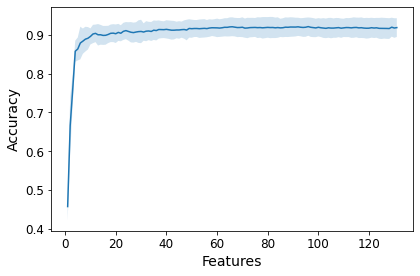

In [270]:
plot_features_cv(rfecv_logit)

Let's use the best features selected in the rfecv with DTC to run the logit classifier. 

In [483]:
logit2 = LogisticRegression(random_state = 5).fit(X_train[rfecv_dtc_best_features], y_train)
logit2_pred = logit2.predict(X_test[rfecv_dtc_best_features])

In [484]:
print(classification_report(y_test, logit2_pred, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.84      0.98      0.90       496
  WALKING_UPSTAIRS       0.88      0.81      0.85       471
WALKING_DOWNSTAIRS       0.96      0.88      0.92       420
           SITTING       0.85      0.77      0.81       491
          STANDING       0.81      0.87      0.84       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.89      2947
         macro avg       0.89      0.89      0.89      2947
      weighted avg       0.89      0.89      0.89      2947



As for the LinearSVC, we now compare the best score obtained by the RFECV Logit with the Logit score obtained over the train set using cross validation.

In [542]:
logit_cvscores = cross_val_score(LogisticRegression(random_state = 5), 
                                 X_train[rfecv_dtc_best_features], y_train, 
                                 cv = 5, n_jobs = -1)

In [543]:
print(f'Mean score = {logit_cvscores.mean():.3} +/- {logit_cvscores.std():.2}')

Mean score = 0.902 +/- 0.04


Here the difference between using the model with 19 instead of the one with 96 features is just 1.85%

In [545]:
rfecv_logit.cv_results_['mean_test_score'].max() - logit_cvscores.mean()

0.018500256662828285

---

 RFECV all models together

In [213]:
RFE_models = [('Decision Tree', rfecv_dtc), ('Linear SVC', rfecv_svc), ('Logit', rfecv_logit)]

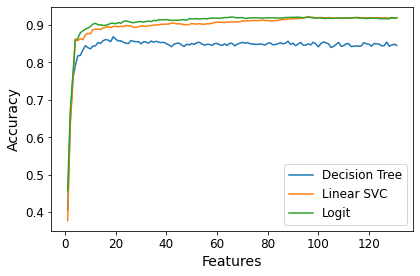

In [399]:
plt.figure(figsize = (6,4), tight_layout = 'True')
for name, rfe_model in RFE_models:
    acc_means = rfe_model.cv_results_['mean_test_score']
    acc_stds = rfe_model.cv_results_['std_test_score']
    x_range = range(1, len(acc_means) + 1)
    plt.plot(x_range, acc_means, label = name)
#     plt.fill_between(x_range, acc_means - acc_stds, acc_means + acc_stds, alpha = 0.1)
plt.legend()
plt.xlabel('Features', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.show()

The figure above depicts that, despite the model used, accuracy enhances steeply in the range $[1, 20]$, and then it becomes almost steady. Moreover, running the Logit and LinearSVC estimators with the best 19 features selected by the RFECV with the decision tree classifier, only entails a small accuracy drop of about 3-4%. This seems consistent with the graph above (in the sense that with 19 features they seem to achieve those scores), but we do not know with which features LinearSVC and Logit classifiers obtained those accuracy scores.

---

###  Filter Strategy

We apply the filter strategy by combining the SelectKBest algorithm with the cross-validation approach in order to select the optimal set of features. That is, we test all the K best attributes according to the score function, from K = 1 to K = 131.

Despite RFECV, SelectKBest with cross-validation removes one feature at a time according to the magnitude of the score function used. This function assigns a score to each feature BEFORE the cross-validation procedure starts.[<sup>1</sup>](#fn1) It is a FILTER approach because the score function is external to the estimator used. On the other hand, RFECV removes one feature at a time according to the coefficients or the feature importances which are computed by the estimator itself at each iteration (EMBEDDED approach). 

The score functions we used with the filter strategy approach are the followings:
* Variance threshold;
* F-test;
* Eta-squared;
* Mutual information.



[<sup id="fn1">1</sup>](#fn1-back) Actually, the SelectKBest algorithm with cross-validation does not "removes" attributes since we are searching for the best K in the range [1,131]. Indeed, this implementation at each iteration enlarges the set of attributes by adding the best feature among those not yet considered.

---

Before applying the filter strategy let's first have a look at the scoring functions we will use. 

#### Variance Threshold

This method is unsupervised because it does not take into account the target variable. Moreover, it is univariate because it considers just one variable at a time.

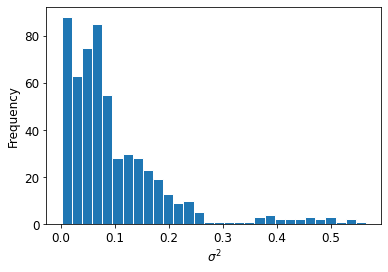

In [29]:
# There are a lot of attributes with very low variance

attr_var = X_train.var()
attr_var.plot.hist(bins = 30, edgecolor = 'w')
plt.xlabel('$\sigma^2$')
plt.show()

In [2]:
# attributes with a var < -0.1

# low_var_attr = attr_var[attr_var < 0.1].index
# for col in low_var_attr:
#     print(features[col])

In [31]:
len(low_var_attr)

373

In [32]:
X_train_var_red = X_train[[col for col in features if col not in low_var_attr]]

In [33]:
X_train_var_red.shape

(7352, 188)

#### Eta-squared

The $\eta^2_{X|Y} = \frac{\sigma^2_{\mathrm{Medie}(X|Y)}}{\sigma^2_X}$ statistics can be used to measure the dependence among quantitative and categorical variables. It varies in $[0,1]$ and can be interpreted as the $R^2$ for quantitative variables or as the Cramér's V ($\chi^2$ normalized) for categorical variables.

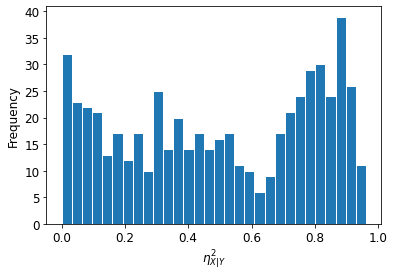

In [35]:
eta = eta_squared(X_train,y_train)
eta.plot.hist(bins = 30, edgecolor = 'w')
plt.xlabel('$\eta^2_{X|Y}$')
plt.show()

In [3]:
# low_eta_attr = eta[eta < 0.5].index
# for col in low_eta_attr:
#     print(features[col])

In [40]:
len(low_eta_attr)

282

In [41]:
X_train_eta_red = X_train[[col for col in features if col not in low_eta_attr]]

In [42]:
X_train_eta_red.shape

(7352, 279)

#### F-test

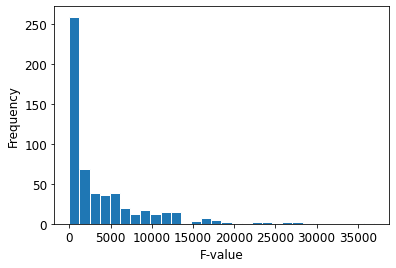

In [43]:
attr_F = F_test(X_train,y_train)
attr_F.plot.hist(bins = 30, edgecolor = 'w')
plt.xlabel('F-value')
plt.show()

In [44]:
attr_F.sort_values()

82         0.241001
81         0.625930
80         0.802546
555        1.390154
161        1.935522
           ...     
49     26686.804095
367    28115.915817
52     28175.402833
40     29362.642369
366    36918.103883
Length: 561, dtype: float64

In [4]:
# low_F_attr = attr_F[attr_F < 1000].index
# for col in low_F_attr:
#     print(features[col])

In [46]:
len(low_F_attr)

233

In [47]:
X_train_F_red = X_train[[col for col in features if col not in low_F_attr]]

In [48]:
X_train_F_red.shape

(7352, 328)

Let's check if the custom function is correct

In [165]:
# best 20 features
sklearn_best = SelectKBest(k=20).fit(X_train, y_train.values.flatten()).get_support(indices=True)
custom_best = attr_F.sort_values(ascending = False)[:20].index

In [166]:
set(sklearn_best) == set(custom_best)

True

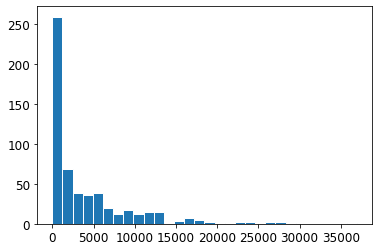

In [18]:
plt.hist(f_classif(X_train, y_train.values.flatten())[0], #tuple: F-values, p_values
         bins = 30, edgecolor = 'w')
plt.show()

#### Mutual Information

It measures the dependency between two variables with the target one discrete (our target variable is discretized). It  measures the reduction in uncertainty for one variable given a known value of the other variable. It is equal to zero if and only if two random variables are independent, and higher values mean higher dependency.

The methods based on F-test estimate the degree of linear dependency between two random variables. On the other hand, mutual information methods can capture any kind of statistical dependency, but being nonparametric, they require more samples for accurate estimation. [1][2]

[1] https://scikit-learn.org/stable/modules/feature_selection.html#univariate-feature-selection

[2] https://scikit-learn.org/stable/auto_examples/feature_selection/plot_f_test_vs_mi.html#comparison-of-f-test-and-mutual-information

In [63]:
mutual_info = mutual_info_classif(X_train, y_train, discrete_features = False, 
                                  random_state = 5)

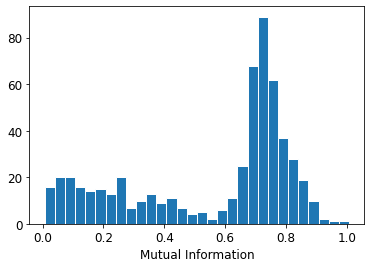

In [64]:
plt.hist(mutual_info, bins = 30, edgecolor = 'w')
plt.xlabel('Mutual Information')
plt.show()

---

Let's now apply the filter strategy

In [335]:
param = {'fs__k': list(range(1, best_features.size + 1))}

In [336]:
# F_test 
# DTC

In [337]:
pipe_dtc = Pipeline([('fs', SelectKBest(score_func = f_classif)), 
                     ('dtc', DTC())])
grid_search_dtc = GridSearchCV(pipe_dtc, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [338]:
grid_search_dtc.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs', SelectKBest()),
                                       ('dtc', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [339]:
# best number of features

grid_search_dtc.best_params_

{'fs__k': 60}

The 61 features with the highest F-value produce the best results in terms of accuracy when used with the DTC.

Since we are using stratified cross-validation the results might slightly change at each iteration.

In [340]:
# best accuracy

grid_search_dtc.best_score_

0.8562331145918598

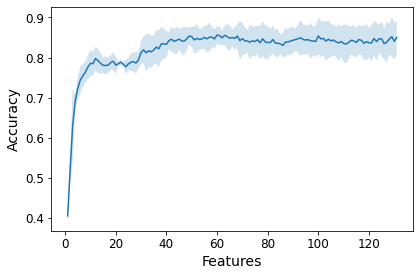

In [341]:
plot_features_cv(grid_search_dtc)

In [342]:
# F_test 
# KNN

In [343]:
pipe_knn = Pipeline([('fs', SelectKBest(score_func = f_classif)),
            ('knn', KNN())])
grid_search_knn = GridSearchCV(pipe_knn, param, scoring = 'accuracy', 
                               n_jobs = -1, cv = 5)

In [344]:
grid_search_knn.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs', SelectKBest()),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [345]:
# best number of features

grid_search_knn.best_params_

{'fs__k': 131}

Surprisingly the KNN performs better with all 131 features

In [346]:
# best accuracy

grid_search_knn.best_score_

0.8951336727757045

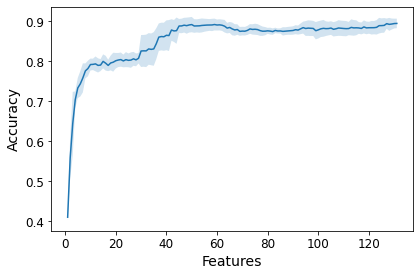

In [347]:
plot_features_cv(grid_search_knn)

However, can be seen that after 45/50 features the funtion is steady. Therefore, we could select the best 45/50 features. 

---

In [336]:
# MI 
# DTC

In [348]:
pipe_dtc_mi = Pipeline([('fs', SelectKBest(score_func = mutual_info_classif)), 
                     ('dtc', DTC())])
grid_search_dtc_mi = GridSearchCV(pipe_dtc_mi, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [349]:
grid_search_dtc_mi.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function mutual_info_classif at 0x000002591A9D5CA0>)),
                                       ('dtc', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [350]:
# best number of features

grid_search_dtc_mi.best_params_

{'fs__k': 111}

In [351]:
# best accuracy

grid_search_dtc_mi.best_score_

0.8584036034536181

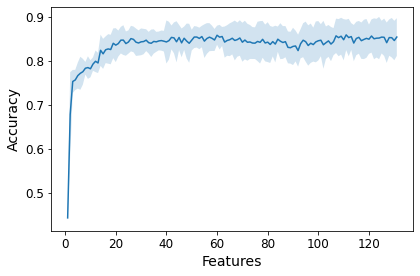

In [352]:
plot_features_cv(grid_search_dtc_mi)

In [ ]:
# MI 
# KNN

In [353]:
pipe_knn_mi = Pipeline([('fs', SelectKBest(score_func = mutual_info_classif)),
                     ('knn', KNN())])
grid_search_knn_mi = GridSearchCV(pipe_knn_mi, param, scoring = 'accuracy', 
                               n_jobs = -1, cv = 5)

In [354]:
grid_search_knn_mi.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function mutual_info_classif at 0x000002591A9D5CA0>)),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [355]:
# best number of features

grid_search_knn_mi.best_params_

{'fs__k': 131}

In [356]:
# best accuracy

grid_search_knn_mi.best_score_

0.8951336727757045

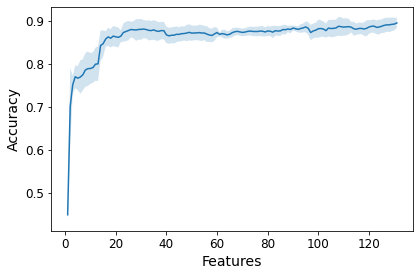

In [357]:
plot_features_cv(grid_search_knn_mi)

In [410]:
# ETA
# DTC

In [361]:
pipe_dtc_eta = Pipeline([('fs', SelectKBest(score_func = eta_squared)), 
                     ('dtc', DTC())])
grid_search_dtc_eta = GridSearchCV(pipe_dtc_eta, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [362]:
grid_search_dtc_eta.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function eta_squared at 0x000002591AA65E50>)),
                                       ('dtc', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [363]:
# best number of features

grid_search_dtc_eta.best_params_

{'fs__k': 63}

In [364]:
# best accuracy

grid_search_dtc_eta.best_score_

0.85813547172778

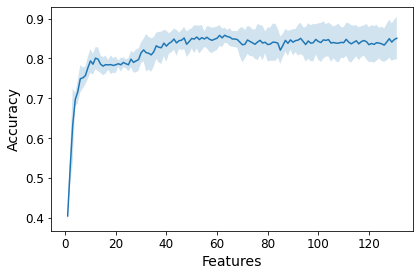

In [365]:
plot_features_cv(grid_search_dtc_eta)

In [366]:
# ETA
# KNN

In [392]:
pipe_knn_eta = Pipeline([('fs', SelectKBest(score_func = eta_squared)), 
                     ('dtc', KNN())])
grid_search_knn_eta = GridSearchCV(pipe_knn_eta, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [393]:
grid_search_knn_eta.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function eta_squared at 0x000002591AA65E50>)),
                                       ('dtc', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [394]:
# best number of features

grid_search_knn_eta.best_params_

{'fs__k': 131}

In [395]:
# best accuracy

grid_search_knn_eta.best_score_

0.8951336727757045

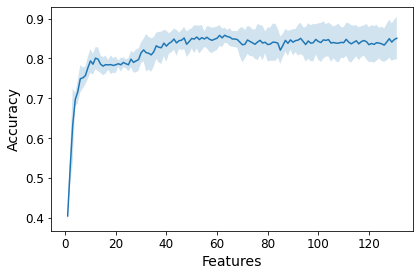

In [396]:
plot_features_cv(grid_search_dtc_eta)

---

In [410]:
# Variance
# DTC

Unlike the other score functions used so far, the variance does not take into account information about labels, thus it is an unsupervised method.

In [459]:
pipe_dtc_var = Pipeline([('fs', SelectKBest(score_func = variance)), 
                     ('dtc', DTC())])
grid_search_dtc_var = GridSearchCV(pipe_dtc_var, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [460]:
grid_search_dtc_var.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function variance at 0x0000025925E0E0D0>)),
                                       ('dtc', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [461]:
# best number of features

grid_search_dtc_var.best_params_

{'fs__k': 73}

In [462]:
# best accuracy

grid_search_dtc_var.best_score_

0.868336316171608

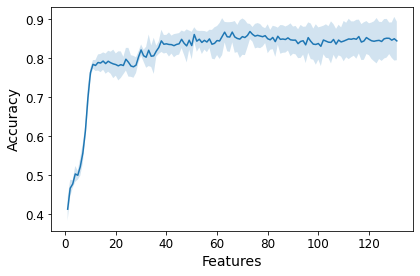

In [463]:
plot_features_cv(grid_search_dtc_var)

In [366]:
# Variance
# KNN

In [464]:
pipe_knn_var = Pipeline([('fs', SelectKBest(score_func = variance)), 
                     ('dtc', KNN())])
grid_search_knn_var = GridSearchCV(pipe_knn_var, param, scoring = 'accuracy', 
                           n_jobs = -1, cv = 5)

In [465]:
grid_search_knn_var.fit(X_train[best_features], y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('fs',
                                        SelectKBest(score_func=<function variance at 0x0000025925E0E0D0>)),
                                       ('dtc', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'fs__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [466]:
# best number of features

grid_search_knn_var.best_params_

{'fs__k': 108}

In [467]:
# best accuracy

grid_search_knn_var.best_score_

0.8958144998312036

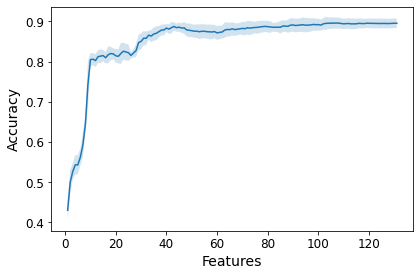

In [468]:
plot_features_cv(grid_search_knn_var)

---

SelectKBestCV all together

In [469]:
SelectKBest_models = [('Decision Tree (F-Test)', grid_search_dtc),
                      ('KNN (F-Test)', grid_search_knn),
                      ('Decision Tree (MI)', grid_search_dtc_mi),
                      ('KNN (MI)', grid_search_knn_mi),
                      ('Decision Tree ($\eta^2$)', grid_search_dtc_eta),
                      ('KNN ($\eta^2$)', grid_search_knn_eta),
                      ('Decision Tree (Variance)', grid_search_dtc_var),
                      ('KNN (Variance)', grid_search_knn_var)]

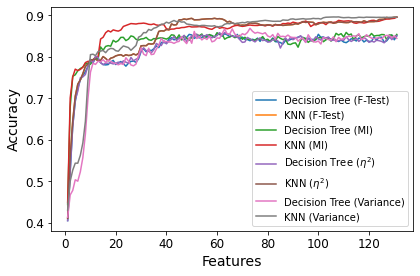

In [471]:
plt.figure(figsize = (6,4), tight_layout = 'True')
for name, model in SelectKBest_models:
    acc_means = model.cv_results_['mean_test_score']
    acc_stds = model.cv_results_['std_test_score']
    x_range = range(1, len(acc_means) + 1)
    plt.plot(x_range, acc_means, label = name)
#     plt.fill_between(x_range, acc_means - acc_stds, acc_means + acc_stds, alpha = 0.1)
plt.legend(fontsize = 'small')
plt.xlabel('Features', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.show()

Generally speaking, in the range $[1,40]$ the Mutual Information approach seems to select the best features with respect to both classifiers (but the score function is really slow). For what concerns the KNN, $\eta^2$ and F-test seem to choose the best 40-65 (approximately) features (orange and brown lines overlap). From 65 on, all the score functions select the same attributes.

---

### Filter vs Embedded approaches

In [478]:
dtc_models = [('F-Test', grid_search_dtc),
              ('MI', grid_search_dtc_mi),
              ('$\eta^2$', grid_search_dtc_eta),
              ('Variance', grid_search_dtc_var),
              ('Embedded', rfecv_dtc)]

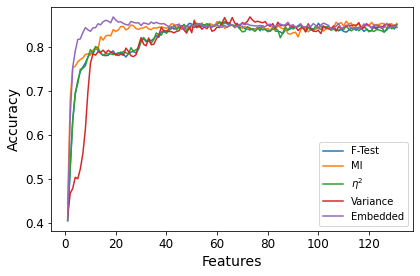

In [716]:
plt.figure(figsize = (6,4), tight_layout = 'True')
for name, model in dtc_models:
    acc_means = model.cv_results_['mean_test_score']
    acc_stds = model.cv_results_['std_test_score']
    x_range = range(1, len(acc_means) + 1)
    plt.plot(x_range, acc_means, label = name)
#     plt.fill_between(x_range, acc_means - acc_stds, acc_means + acc_stds, alpha = 0.1)
plt.legend(fontsize = 'small')
plt.xlabel('Features', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.show()

Finally, comparing filter and embedded approaches with respect to the DTC we can note that the embedded method selects the best features up to 40, then both approaches perform the same. Moreover, the performance pinnacle is reached in correspondence with the 19 features selected by the embedded method.

### Wrapper approach

As a very last thing, we want to see if it is possible to enlarge the set of 19 DTC Embedded selected attributes with the ones with the higher score selected by the various filter methods (of course if they are not been already selected).

In [762]:
mi_best_idx = np.argsort(mutual_info)[::-1][:22]
f_best_idx = np.argsort(attr_F)[::-1][:12].values
eta_best_idx = np.argsort(eta)[::-1][:12].values
var_best_idx = np.argsort(attr_var)[::-1][:12].values

In [889]:
filter_best_attr = [mi_best_idx, eta_best_idx, f_best_idx, var_best_idx]
# join the arrays preserving the order and removing duplicates
filter_best_attr = dict.fromkeys(np.concatenate(filter_best_attr))
ensamble_features = set(rfecv_dtc_best_features)
for attr in ensamble_features:
    if attr in filter_best_attr:
        del filter_best_attr[attr]
        
max_accuracy = rfecv_dtc.cv_results_['mean_test_score'].max()
new_features = []
while filter_best_attr:
    added_features = set()
    n_added = 0
    for attr in filter_best_attr:        
        temp_features = ensamble_features.copy()
        temp_features.add(attr)
        cls = DTC(random_state = 5)
        scores = cross_val_score(cls, X_train[temp_features], y_train, 
                                 cv = 5, n_jobs = -1)
        mean_score = scores.mean()
        if mean_score > max_accuracy:
            ensamble_features.add(attr)
            added_features.add(attr)
            new_features.append(attr)
            n_added += 1
            max_accuracy = mean_score
    print(n_added)
    if not added_features:
        break
    for attr in added_features:
        del filter_best_attr[attr]

3
2
0


In [890]:
max_accuracy

0.88398118730837

In [891]:
# added features 

for attr in new_features:
    print(features[attr])
print(new_features)

tGravityAcc-min()-Y
fBodyAccJerk-entropy()-X
fBodyAccJerk-entropy()-Y
fBodyAcc-bandsEnergy()-1,8
tGravityAcc-correlation()-X,Z
[53, 366, 367, 302, 78]


In [892]:
increment = max_accuracy - rfecv_dtc.cv_results_['mean_test_score'].max()
print(f'{increment:.2%}')

1.58%


In the end, we added 5 features and obtained a 1.58% increase in accuracy.

In [895]:
selected_attr = np.concatenate((rfecv_dtc_best_features, new_features))

In [897]:
# Overall we have reduced the dataset from 561 to 24 features

selected_attr.size

24

In [898]:
X_train_fs, X_test_fs = X_train[selected_attr], X_test[selected_attr]

In [899]:
# save the new data sets

# X_train_fs.to_csv('X_train_fs.csv', index = False)
# X_test_fs.to_csv('X_test_fs.csv', index = False)

In [95]:
fs_names = [features[col] for col in X_train_fs.columns]

In [96]:
fs_names

['tBodyAcc-correlation()-X,Y',
 'tGravityAcc-max()-Y',
 'tGravityAcc-min()-X',
 'tGravityAcc-min()-Z',
 'tGravityAcc-energy()-Y',
 'tGravityAcc-arCoeff()-X,3',
 'tGravityAcc-arCoeff()-Z,2',
 'tBodyAccJerk-correlation()-X,Y',
 'tBodyGyro-max()-X',
 'tBodyGyro-min()-X',
 'tBodyGyro-iqr()-X',
 'tBodyGyro-correlation()-Y,Z',
 'tGravityAccMag-arCoeff()1',
 'fBodyAcc-max()-Y',
 'fBodyAccJerk-bandsEnergy()-1,24',
 'fBodyGyro-iqr()-Y',
 'fBodyGyro-maxInds-X',
 'fBodyAccMag-energy()',
 'angle(Y,gravityMean)',
 'tGravityAcc-min()-Y',
 'fBodyAccJerk-entropy()-X',
 'fBodyAccJerk-entropy()-Y',
 'fBodyAcc-bandsEnergy()-1,8',
 'tGravityAcc-correlation()-X,Z']

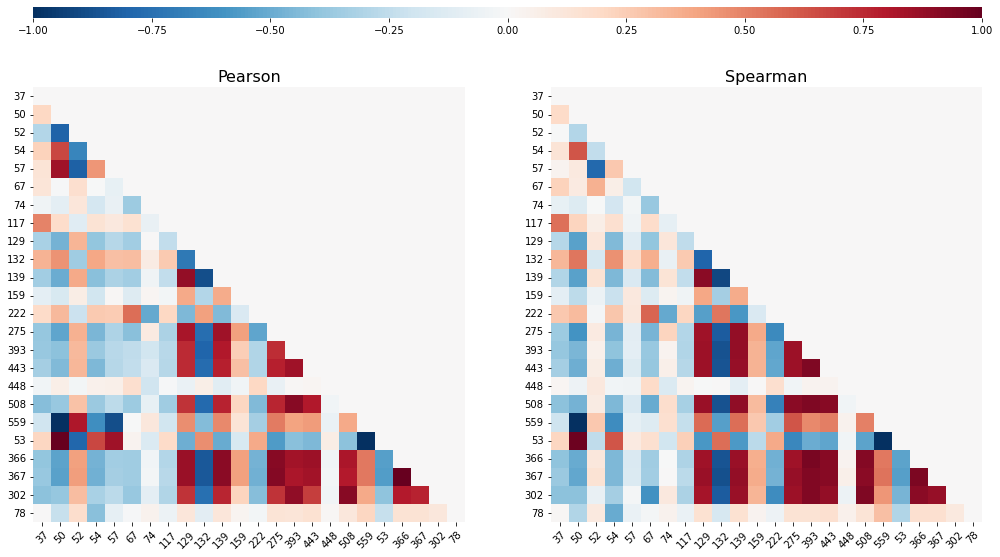

In [149]:
# Correlation among the selected 24 features 

fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (17, 8))
ax1, ax2 = axes
cols = X_train_fs.columns

corr_mtx = X_train_fs.corr()
corr_mtx = np.tril(corr_mtx, -1)
pearson = sns.heatmap(corr_mtx, cmap = my_color, ax = ax1, cbar = False)
ax1.set_yticks(ax1.get_yticks(), cols, rotation = 0)
ax1.set_xticks(ax1.get_xticks(), cols, rotation = 45)
ax1.set_title('Pearson', fontsize = 16)

cbar_ax = fig.add_axes([0.125, 1, 0.775, 0.02])
corr_mtx_spearm = X_train_fs.corr(method = 'spearman')
corr_mtx_spearm = np.tril(corr_mtx_spearm, -1)
spearman = sns.heatmap(corr_mtx_spearm, cmap = 'RdBu_r', ax = ax2, vmin = -1, vmax = 1, cbar_ax=cbar_ax,
                       cbar_kws={ "orientation": "horizontal" })
ax2.set_yticks(ax2.get_yticks(), cols, rotation = 0)
ax2.set_xticks(ax2.get_xticks(), cols, rotation = 45)
ax2.set_title('Spearman', fontsize = 16)

# ax1.get_position().get_points().flatten()
# ax2.get_position().get_points().flatten()

plt.show()

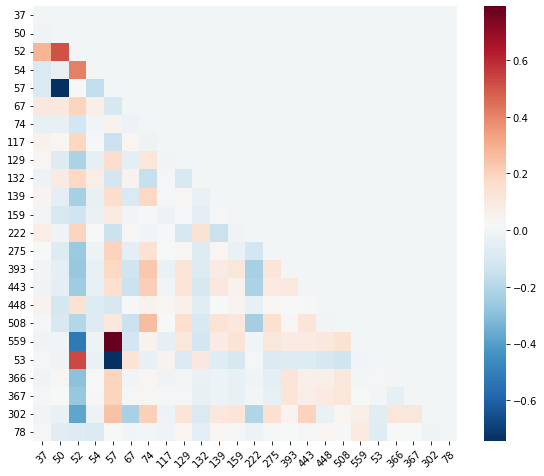

In [150]:
# difference between the two matrices: Spearman - Pearson

plt.figure(figsize=(9.5,8))
diff_corr_mtx = X_train_fs.corr(method = 'spearman') - X_train_fs.corr()
sns.heatmap(np.tril(diff_corr_mtx, -1), cmap = 'RdBu_r')
ax = plt.gca()
ax.set_yticks(ax.get_yticks(), cols, rotation = 0)
ax.set_xticks(ax.get_xticks(), cols, rotation = 45)
plt.show()

---

### Classification with the reduced dataset 

In [21]:
X_train_fs

,37,50,52,54,57,67,74,117,129,132,...,393,443,448,508,559,53,366,367,302,78
0,0.376314,-0.161265,0.977436,0.056483,-0.970905,-0.591773,0.995675,-0.385300,-0.867044,0.847308,...,-0.999981,-0.994836,-1.000000,-0.998285,0.179941,-0.123213,-1.000000,-1.000000,-0.999963,0.439027
1,-0.013429,-0.161343,0.984520,0.102764,-0.970583,-0.417567,0.834271,-0.208772,-0.864904,0.833721,...,-0.999974,-0.995564,-1.000000,-0.999472,0.180289,-0.114893,-1.000000,-1.000000,-0.999996,-0.865711
2,-0.124698,-0.163711,0.986770,0.102764,-0.970368,-0.056728,0.714392,-0.120105,-0.864904,0.833721,...,-0.999909,-0.995392,-1.000000,-0.999807,0.180637,-0.114893,-1.000000,-1.000000,-0.999989,0.337936
3,-0.305693,-0.163711,0.986821,0.095753,-0.969400,-0.085823,0.386373,-0.127495,-0.885320,0.834164,...,-0.999927,-0.996289,-1.000000,-0.999770,0.181935,-0.121336,-1.000000,-1.000000,-0.999989,-0.968821
4,-0.155804,-0.166786,0.987434,0.094059,-0.967051,-0.280665,0.239268,-0.272884,-0.870154,0.839091,...,-0.999975,-0.996123,-1.000000,-0.999873,0.185151,-0.121834,-1.000000,-1.000000,-0.999994,-0.184840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7347,-0.211822,-0.214233,0.920554,-0.071977,-0.918375,-0.697090,0.802503,-0.523499,-0.414164,0.347141,...,-0.724214,-0.503385,-1.000000,-0.584282,0.238604,-0.234998,0.546273,0.455341,-0.684177,-0.390766
7348,-0.198555,-0.231477,0.920554,-0.068919,-0.902880,-0.694761,0.721749,-0.460900,-0.414164,0.518533,...,-0.767363,-0.617957,-0.933333,-0.632536,0.252676,-0.234998,0.372223,0.357697,-0.726986,-0.272643
7349,-0.226826,-0.249134,0.933008,-0.068919,-0.907561,-0.677800,0.835444,-0.534302,-0.519895,0.342910,...,-0.757269,-0.541557,-0.933333,-0.641170,0.249145,-0.216004,0.465329,0.422191,-0.655263,-0.119819
7350,-0.257775,-0.244267,0.933008,-0.040009,-0.910648,-0.702518,0.858624,-0.551732,-0.685665,0.342910,...,-0.780800,-0.717575,-0.933333,-0.663579,0.246432,-0.210542,0.417495,0.346965,-0.643425,-0.506638


In [8]:
# load data sets

X_train_fs = pd.read_csv('X_train_fs.csv')
X_train_fs.columns = X_train_fs.columns.astype(int)
X_test_fs = pd.read_csv('X_test_fs.csv')
X_test_fs.columns = X_test_fs.columns.astype(int)

#### Decision Tree (FS dataset)

In [903]:
param = {'min_samples_leaf': list(range(10, 51, 5)),
         'max_leaf_nodes': list(range(4, 35, 2))}
grid_search = GridSearchCV(DTC(random_state=5), param, scoring = 'accuracy',
                           cv = 5, n_jobs = -1)

In [904]:
grid_search.fit(X_train_fs, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=5), n_jobs=-1,
             param_grid={'max_leaf_nodes': [4, 6, 8, 10, 12, 14, 16, 18, 20, 22,
                                            24, 26, 28, 30, 32, 34],
                         'min_samples_leaf': [10, 15, 20, 25, 30, 35, 40, 45,
                                              50]},
             scoring='accuracy')

In [905]:
report(grid_search.cv_results_)

Model with rank: 1
Mean validation score: 0.893 (std: 0.015)
Parameters: {'max_leaf_nodes': 28, 'min_samples_leaf': 20}

Model with rank: 2
Mean validation score: 0.893 (std: 0.015)
Parameters: {'max_leaf_nodes': 34, 'min_samples_leaf': 10}

Model with rank: 3
Mean validation score: 0.892 (std: 0.016)
Parameters: {'max_leaf_nodes': 32, 'min_samples_leaf': 10}



In [906]:
best_estimator = grid_search.best_estimator_

In [907]:
depth = best_estimator.get_depth()
n_leaves = best_estimator.get_n_leaves()

print(f'tree depth = {depth} \nnumber of leaves = {n_leaves}')

tree depth = 8 
number of leaves = 28


In [908]:
best_score = grid_search.best_score_

print(f'Mean cross-validated accuracy = {best_score:.3}')

Mean cross-validated accuracy = 0.893


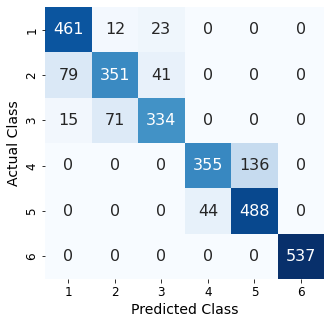

In [909]:
y_pred = best_estimator.predict(X_test_fs)
cm = confusion_matrix(y_test, y_pred)
plot_confusion_mtx(cm, binary = False, figsize=(5,5))

In [910]:
print(classification_report(y_test, y_pred, 
      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.83      0.93      0.88       496
  WALKING_UPSTAIRS       0.81      0.75      0.78       471
WALKING_DOWNSTAIRS       0.84      0.80      0.82       420
           SITTING       0.89      0.72      0.80       491
          STANDING       0.78      0.92      0.84       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.86      2947
         macro avg       0.86      0.85      0.85      2947
      weighted avg       0.86      0.86      0.86      2947



The accuracy obtained on the test set is very close to the one computed on the validation set during the cross-validation, thus there is no overfitting.

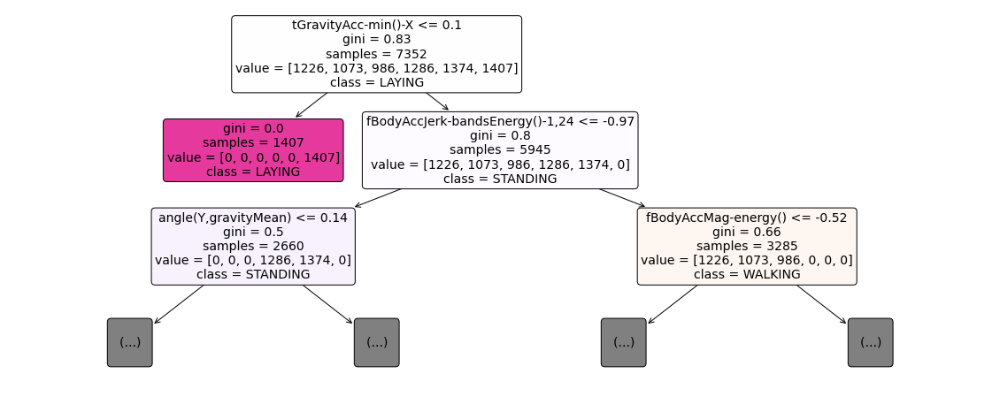

In [911]:
plt.figure(figsize = (20,8))
class_names = [lab for lab in activities.values()]
tree.plot_tree(best_estimator, feature_names = fs_names, max_depth = 2,
               precision = 2, filled = True, class_names = class_names, 
               rounded = True, fontsize = 14) 
# plt.savefig('full_Tree.pdf',bbox_inches = 'tight')
plt.show()

The chosen classifier is able to detect all the 1407 instances belonging to the LAYING class after the first split test: tGravityAcc-min()-X $\leq 0.1$. The second test, fBodyAccJerk-bandsEnergy()-1,24 $\leq −0.97$, perfectly splits the residual stationary activities from the movement ones putting them in two separate branches: L and R.

L) In the left branch, the test angle(Y,gravityMean) $\leq 0.14$ distinguishes almost perfectly between SITTING and STANDING activities: the left child stores 1357 records, 1173 of which belong to the SITTING class and 184 to the STANDING class; on the other hand, the right child stores 1190 objects marked with the STANDING label and 113 with the SITTING one. From here on, the two branches continue to grow by going down for a maximum of 5 and 2 levels respectively.

R) The right branch, instead, is more complex because the tree struggles to distinguish among movement activities. The test fBodyAccMag-energy() $\leq -0.52$ performs a good distinction between the WALKING_DOWNSTAIRS and the other two classes. Then the test tGravityAcc-arCoeff()-Z,2 $\leq 0.56$  distinguishes in a good way between WALKING and WALKING_UPSTAIRS. From here on it becomes more difficult for the tree distinguishes among the movement activities.

In [912]:
feature_importances = pd.Series(best_estimator.feature_importances_, 
                                index = fs_names).sort_values()

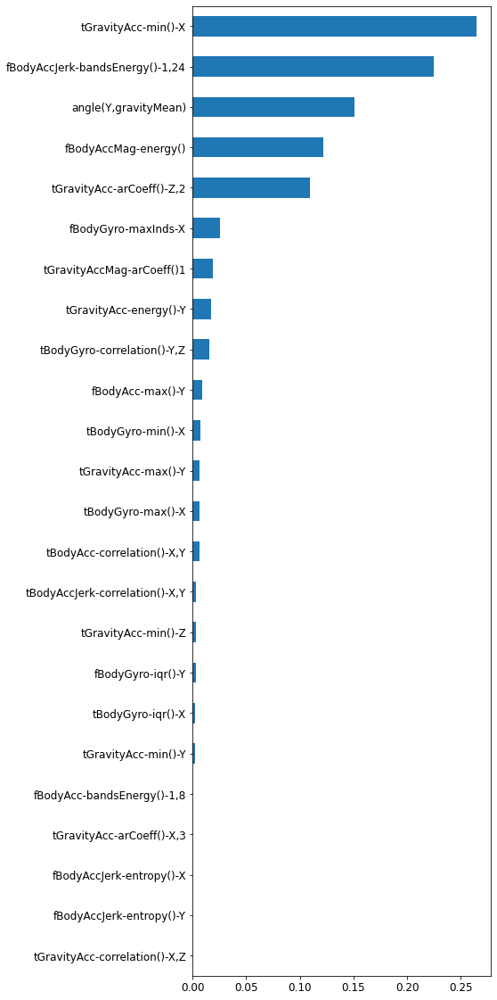

In [913]:
plt.figure(figsize=(6,20))

feature_importances.plot.barh()
plt.show()

Let's check how many unique values there are for each feature because mpurity-based feature importances can be misleading for high cardinality features. For this reason it is suggested to use the permutation importance. [1] [2]

[1] https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html?highlight=feature%20importances#sklearn.tree.DecisionTreeClassifier.feature_importances_

[2] https://scikit-learn.org/stable/modules/permutation_importance.html#permutation-feature-importance

In [927]:
for col in X_train_fs.columns:
    print(features[col], X_train_fs[col].unique().size, sep = '\t')

tBodyAcc-correlation()-X,Y	7352
tGravityAcc-max()-Y	5768
tGravityAcc-min()-X	5617
tGravityAcc-min()-Z	5726
tGravityAcc-energy()-Y	7348
tGravityAcc-arCoeff()-X,3	7350
tGravityAcc-arCoeff()-Z,2	7352
tBodyAccJerk-correlation()-X,Y	7352
tBodyGyro-max()-X	5439
tBodyGyro-min()-X	5399
tBodyGyro-iqr()-X	7351
tBodyGyro-correlation()-Y,Z	7352
tGravityAccMag-arCoeff()1	7352
fBodyAcc-max()-Y	7352
fBodyAccJerk-bandsEnergy()-1,24	7032
fBodyGyro-iqr()-Y	7350
fBodyGyro-maxInds-X	27
fBodyAccMag-energy()	7291
angle(Y,gravityMean)	7352
tGravityAcc-min()-Y	5681
fBodyAccJerk-entropy()-X	3313
fBodyAccJerk-entropy()-Y	3359
fBodyAcc-bandsEnergy()-1,8	6876
tGravityAcc-correlation()-X,Z	7352


In [928]:
perm_importances = permutation_importance(best_estimator, X_train_fs, y_train, 
                                          scoring = 'accuracy', n_repeats = 20, 
                                          n_jobs = -1, random_state = 5)

In [151]:
# perm_importances

In [930]:
adj_feature_importances = pd.Series(perm_importances.importances_mean, 
                                    index = fs_names).sort_values()

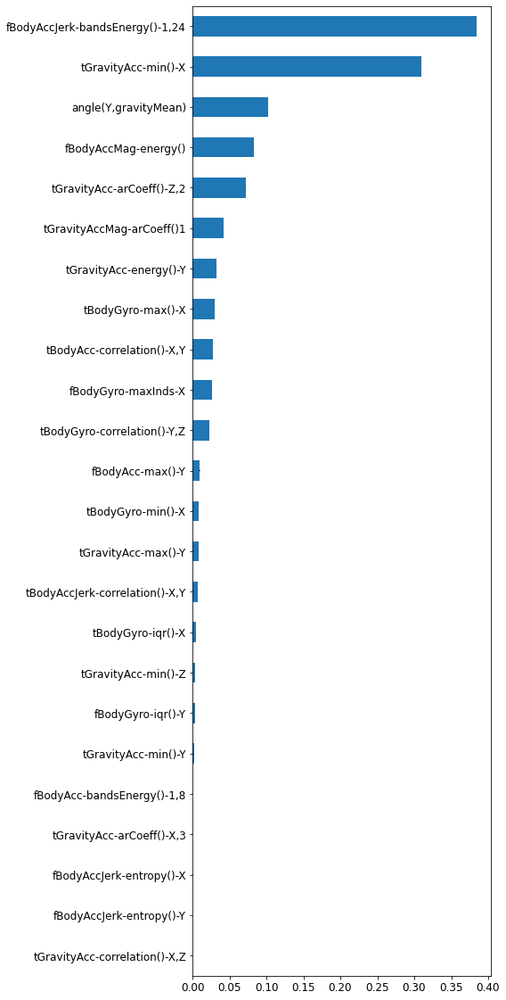

In [932]:
plt.figure(figsize=(6,20))
adj_feature_importances.plot.barh(yerr = perm_importances.importances_std)
plt.show()

In [1027]:
# save the model

# with open('DTC_fs_tuned.pkl', 'wb') as f:
#     pickle.dump(best_estimator,f)

In [ ]:
# load the model

with open('DTC_fs_tuned.pkl', 'rb') as f:
    best_estimator = pickle.load(f)   

#### K-Nearest Neighbor Classifier (FS dataset)

Plain KNN used on the dataset with all 561 initial features and without modifying any parameter

In [74]:
knn_clf = KNN().fit(X_train, y_train.values.ravel())

In [75]:
predictions = knn_clf.predict(X_test)

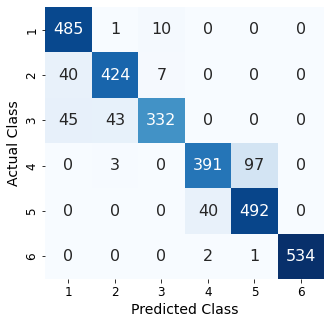

In [76]:
cm = confusion_matrix(y_test, predictions)
plot_confusion_mtx(cm, binary = False, figsize = (5,5))

In [77]:
print(classification_report(y_test, predictions, 
      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.85      0.98      0.91       496
  WALKING_UPSTAIRS       0.90      0.90      0.90       471
WALKING_DOWNSTAIRS       0.95      0.79      0.86       420
           SITTING       0.90      0.80      0.85       491
          STANDING       0.83      0.92      0.88       532
            LAYING       1.00      0.99      1.00       537

          accuracy                           0.90      2947
         macro avg       0.91      0.90      0.90      2947
      weighted avg       0.91      0.90      0.90      2947



---

KNN with hyperparameter tuning using the 24 features selected in the previous analysis

In [1016]:
param_knn = {'n_neighbors': list(range(1,21)),
             'weights': ['uniform', 'distance'],
             'metric': ['manhattan', 'euclidean', 'chebyshev', 'mahalanobis']}

grid_search_knn = GridSearchCV(KNN(), param_knn, cv = 5,
                               n_jobs = -1, scoring = 'accuracy')              

In [1017]:
grid_search_knn.fit(X_train_fs, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'metric': ['manhattan', 'euclidean', 'chebyshev',
                                    'mahalanobis'],
                         'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14, 15, 16, 17, 18, 19, 20],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy')

In [1018]:
best_knn_clf = grid_search_knn.best_estimator_
best_knn_clf

KNeighborsClassifier(metric='manhattan', n_neighbors=15, weights='distance')

In [1019]:
report(grid_search_knn.cv_results_)

Model with rank: 1
Mean validation score: 0.907 (std: 0.017)
Parameters: {'metric': 'manhattan', 'n_neighbors': 15, 'weights': 'distance'}

Model with rank: 2
Mean validation score: 0.907 (std: 0.016)
Parameters: {'metric': 'manhattan', 'n_neighbors': 12, 'weights': 'uniform'}

Model with rank: 3
Mean validation score: 0.907 (std: 0.015)
Parameters: {'metric': 'manhattan', 'n_neighbors': 20, 'weights': 'uniform'}



In [1021]:
grid_search_knn.best_score_

0.9071022997914324

In [1026]:
with open('KNN_fs_tuned.pkl', 'wb') as f:
    pickle.dump(best_knn_clf, f)

In [ ]:
with open('KNN_fs_tuned.pkl', 'rb') as f:
    best_knn_clf = pickle.load(f)

In [1023]:
y_pred_knn = best_knn_clf.predict(X_test_fs)

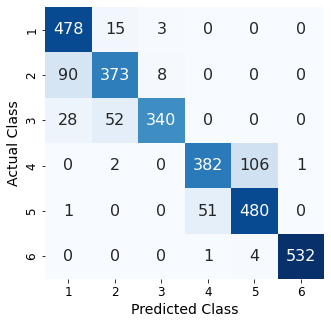

In [1024]:
cm = confusion_matrix(y_test, y_pred_knn)
plot_confusion_mtx(cm, binary = False, figsize=(5,5))

In [1025]:
print(classification_report(y_test, y_pred_knn, 
      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.80      0.96      0.87       496
  WALKING_UPSTAIRS       0.84      0.79      0.82       471
WALKING_DOWNSTAIRS       0.97      0.81      0.88       420
           SITTING       0.88      0.78      0.83       491
          STANDING       0.81      0.90      0.86       532
            LAYING       1.00      0.99      0.99       537

          accuracy                           0.88      2947
         macro avg       0.88      0.87      0.87      2947
      weighted avg       0.88      0.88      0.88      2947



We lost 2-3% performances with respect to the plain KNN trained and tested on the dataset with 561 features

## Feature Extraction

### PCA

Let's find the optimal number of principal components performing an hyperparameter tuning.

In [ ]:
param_pca = {'pca__n_components': list(range(1,50))}

In [976]:
pipe_pca_dtc = Pipeline([('pca', PCA(random_state = 5)), 
                     ('dtc', DTC(random_state = 5))])

grid_search_pca_dtc = GridSearchCV(pipe_pca_dtc, param_pca, scoring = 'accuracy',
                               cv = 5, n_jobs = -1)

In [977]:
grid_search_pca_dtc.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('pca', PCA(random_state=5)),
                                       ('dtc',
                                        DecisionTreeClassifier(random_state=5))]),
             n_jobs=-1,
             param_grid={'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                                               19, 20, 21, 22, 23, 24, 25, 26,
                                               27, 28, 29, 30, ...]},
             scoring='accuracy')

In [978]:
# best number of components

grid_search_pca_dtc.best_params_

{'pca__n_components': 24}

In [979]:
# max accuracy reached

grid_search_pca_dtc.best_score_

0.8022301456272516

PCA reaches the maximum accuracy with 24 principal components. The number of artificial features needed to achieve such a score is very high. Despite that, the accuracy reached is roughly 6% lower than the one obtained with the 24 attributes selected in the feature selection analysis.

In [987]:
pipe_pca_knn = Pipeline([('pca', PCA(random_state = 5)), 
                         ('knn', DTC(random_state = 5))])

grid_search_pca_knn = GridSearchCV(pipe_pca_knn, param_pca, scoring = 'accuracy',
                               cv = 5, n_jobs = -1)

In [988]:
grid_search_pca_knn.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('pca', PCA(random_state=5)),
                                       ('knn',
                                        DecisionTreeClassifier(random_state=5))]),
             n_jobs=-1,
             param_grid={'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                                               19, 20, 21, 22, 23, 24, 25, 26,
                                               27, 28, 29, 30, ...]},
             scoring='accuracy')

In [989]:
grid_search_pca_knn.best_params_

{'pca__n_components': 24}

In [990]:
grid_search_pca_knn.best_score_

0.8022301456272516

Even using the KNN classifier the situation does not change. In conclusion, the best solution is to use the 24 features selected in the FS analysis.

In [103]:
n_comp = 24
pca = PCA(n_components = n_comp, random_state = 5).fit(X_train)

In [194]:
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

In [193]:
pca_dtc = DTC(random_state = 5).fit(X_train_pca, y_train)

In [195]:
y_pred_pca_dtc = pca_dtc.predict(X_test_pca)

In [197]:
print(classification_report(y_test, y_pred_pca_dtc, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.75      0.84      0.79       496
  WALKING_UPSTAIRS       0.78      0.72      0.75       471
WALKING_DOWNSTAIRS       0.72      0.70      0.71       420
           SITTING       0.71      0.69      0.70       491
          STANDING       0.74      0.79      0.76       532
            LAYING       0.99      0.94      0.96       537

          accuracy                           0.78      2947
         macro avg       0.78      0.78      0.78      2947
      weighted avg       0.79      0.78      0.78      2947



In [205]:
pca_knn = KNN().fit(X_train_pca, y_train)

In [206]:
y_pred_pca_knn = pca_knn.predict(X_test_pca)

In [207]:
print(classification_report(y_test, y_pred_pca_knn, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.83      0.95      0.89       496
  WALKING_UPSTAIRS       0.87      0.87      0.87       471
WALKING_DOWNSTAIRS       0.90      0.76      0.83       420
           SITTING       0.81      0.77      0.79       491
          STANDING       0.80      0.87      0.83       532
            LAYING       1.00      0.97      0.98       537

          accuracy                           0.87      2947
         macro avg       0.87      0.86      0.87      2947
      weighted avg       0.87      0.87      0.87      2947



#### PCA visualization

In [186]:
expl_var = pca.explained_variance_ratio_
cum_expl_var = list(accumulate(expl_var))

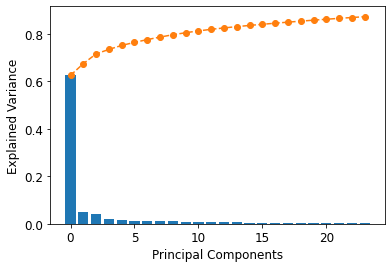

In [192]:
plt.figure(figsize = (6,4))
plt.bar(range(n_comp), expl_var)
plt.plot(cum_expl_var, 'o--', color = my_colors[1])
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
# plt.savefig('pca_explained_var.pdf', bbox_inches = 'tight')
plt.show()

The first component explains more than 63% of the variance of all 561 variables. However, all other components explain a very small percentage of the residual variance. To achieve a significative explained variance (>80% maybe?), we need to use more than 11 components.

In [191]:
# setting the to 24 number of components (optimal number), the maximal 
# cumulative explained variance is 

format(cum_expl_var[-1], '.2%')

'87.23%'

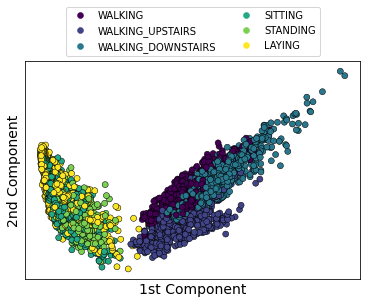

In [166]:
plot_scatter(X_train_pca, y_train, activities)
# plt.savefig('pca_2d.pdf', bbox_inches = 'tight')
plt.show()

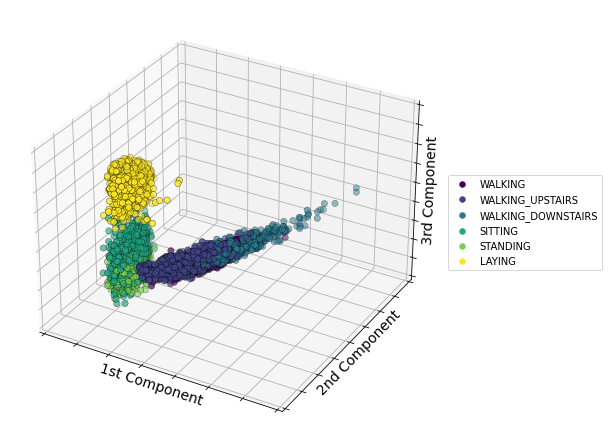

In [183]:
plot_scatter3d(X_train_pca, y_train, activities)
# plt.savefig('pca_3d.pdf', bbox_inches = 'tight')
plt.show()

Let's plot the decision boundaries for both decision tree and K-nearest neighbors classifiers. The hyperparameters of the two models are not tuned.

However, for both the classifiers, the accuracy achieved with 2 components is ridiculous.

<Figure size 432x288 with 0 Axes>

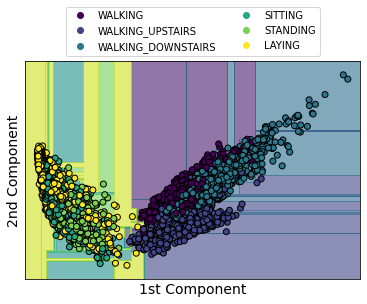

In [968]:
plt.figure(figsize = (6,4), tight_layout = True)
clf_dtc = DTC(random_state = 5).fit(X_train_pca[:,:2], y_train)
plot_decision_boundaries(X_train_pca[:,:2], y_train, clf_dtc, 
                         class_names = activities)
# plt.savefig('DTC_decision_boundaries.pdf', bbox_inches = 'tight')
plt.show()

In [106]:
cross_val_score(DTC(random_state = 5), X_train_pca[:,:2], y_train, cv = 5).mean()

0.5146923052021625

<Figure size 432x288 with 0 Axes>

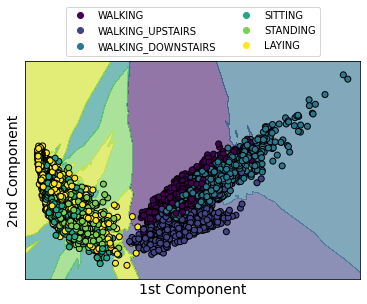

In [969]:
plt.figure(figsize = (6,4), tight_layout = True)
clf_knn = KNN(n_jobs = -1).fit(X_train_pca[:,:2], y_train)
plot_decision_boundaries(X_train_pca[:,:2], y_train, clf_knn, 
                         class_names = activities)
# plt.savefig('KNN_decision_boundaries.pdf', bbox_inches = 'tight')
plt.show()

Note that KNN allow also non-linear boundaries, whereas the DTC always defines decision boundaries parallel to the axes.

In [107]:
cross_val_score(KNN(), X_train_pca[:,:2], y_train, cv = 5).mean()

0.5511432363564052

---

### Isomap

Isomap is a non-linear dimensionality reduction through Isometric Mapping

In [1054]:
param_iso = {'iso__n_components': list(range(1,30))}

In [1055]:
pipe_iso = Pipeline([('iso', Isomap()), 
                     ('dtc', DTC(random_state = 5))])
grid_search_iso = GridSearchCV(pipe_iso, param_iso, scoring = 'accuracy',
                              cv = 3, n_jobs = -1)

In [1058]:
grid_search_iso.fit(X_train_fs, y_train)

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('iso', Isomap()),
                                       ('dtc',
                                        DecisionTreeClassifier(random_state=5))]),
             n_jobs=-1,
             param_grid={'iso__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                                               19, 20, 21, 22, 23, 24, 25, 26,
                                               27, 28, 29]},
             scoring='accuracy')

In [1059]:
grid_search_iso.best_params_

{'iso__n_components': 7}

In [1060]:
grid_search_iso.best_score_

0.81828208394741

In [200]:
iso = Isomap(n_neighbors = 4, n_components = 7, n_jobs = -1)
X_train_iso = iso.fit_transform(X_train)
X_test_iso = iso.transform(X_test)

In [203]:
iso_dtc = DTC(random_state = 5).fit(X_train_iso, y_train)
y_pred_iso_dtc = iso_dtc.predict(X_test_iso)

In [204]:
print(classification_report(y_test, y_pred_iso_dtc, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.84      0.89      0.86       496
  WALKING_UPSTAIRS       0.84      0.84      0.84       471
WALKING_DOWNSTAIRS       0.82      0.75      0.78       420
           SITTING       0.68      0.61      0.64       491
          STANDING       0.68      0.75      0.71       532
            LAYING       0.98      0.98      0.98       537

          accuracy                           0.81      2947
         macro avg       0.81      0.80      0.80      2947
      weighted avg       0.81      0.81      0.81      2947



In [209]:
iso_knn = KNN().fit(X_train_iso, y_train)
y_pred_iso_knn = iso_knn.predict(X_test_iso)

In [210]:
print(classification_report(y_test, y_pred_iso_knn, 
                            target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.86      0.91      0.89       496
  WALKING_UPSTAIRS       0.86      0.87      0.86       471
WALKING_DOWNSTAIRS       0.85      0.78      0.82       420
           SITTING       0.78      0.60      0.68       491
          STANDING       0.70      0.86      0.77       532
            LAYING       1.00      0.99      1.00       537

          accuracy                           0.84      2947
         macro avg       0.84      0.84      0.84      2947
      weighted avg       0.84      0.84      0.84      2947



#### Isomap visualization

In [391]:
neighbors = [2,3,4,5,10,20,30]
iso_models = []
for n in neighbors:
    iso = Isomap(n_neighbors = n, n_components = 2, n_jobs = -1)
    X_train_iso = iso.fit_transform(X_train)
    iso_models.append(X_train_iso)

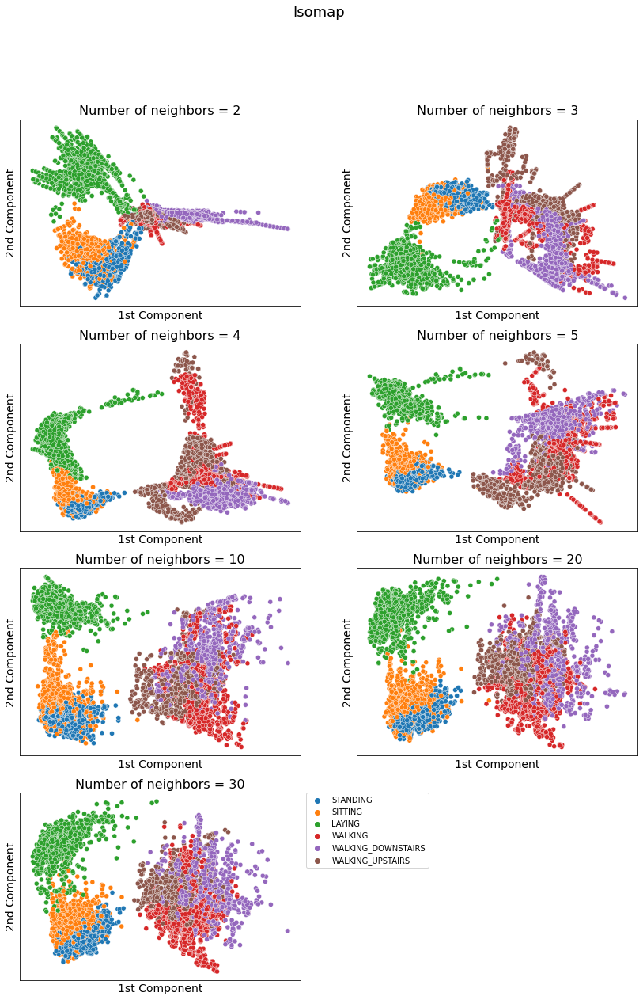

In [435]:
plt.figure(figsize = (14, 20))
plt.suptitle('Isomap', fontsize = 18)
for i, model in enumerate(iso_models, 1):
    plt.subplot(4, 2, i)
    plot_scatter(model, y_train_mapped)
    plt.title(f'Number of neighbors = {neighbors[i-1]}', fontsize = 16)
    if i != 7:
        plt.legend([], [], frameon = False)
plt.show()

The number of neighbors does not seem to make a big difference. The stationary activities are well separated, whereas the algorithm struggles to distinguish among the movement ones.

In [167]:
iso = Isomap(n_neighbors = 4, n_components = 3, n_jobs = -1)
X_train_iso = iso.fit_transform(X_train)

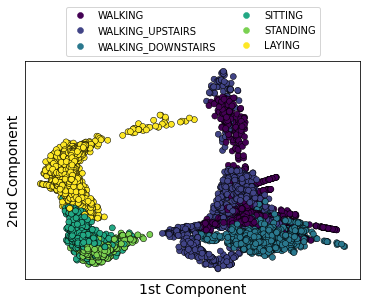

In [169]:
plot_scatter(X_train_iso, y_train, activities)
# plt.savefig('isomap_2d.pdf', bbox_inches = 'tight')
plt.show()

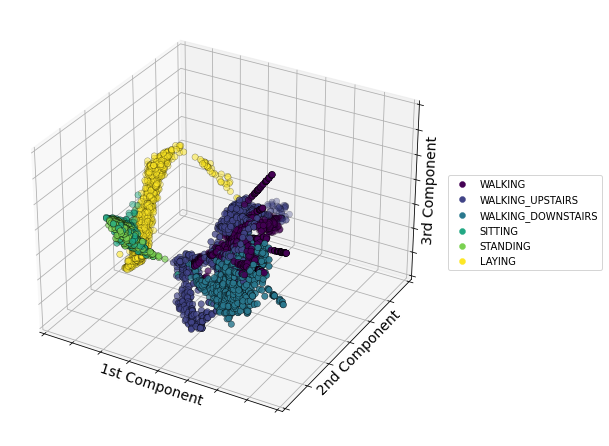

In [179]:
plot_scatter3d(X_train_iso, y_train, activities)
# plt.savefig('isomap_3d.pdf', bbox_inches = 'tight')
plt.show()

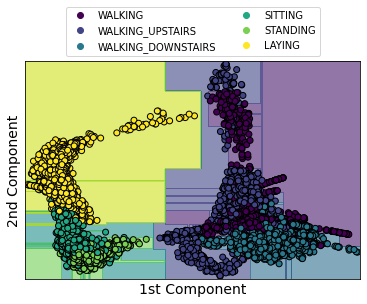

In [172]:
clf_dtc_iso = DTC(random_state = 5).fit(X_train_iso[:,:2], y_train)
plot_decision_boundaries(X_train_iso[:,:2], y_train, clf_dtc_iso, 
                         class_names = activities)
# plt.savefig('DTC_decision_boundaries_isomap.pdf', bbox_inches = 'tight')
plt.show()

Better than PCA but still too bad

In [173]:
cross_val_score(DTC(random_state = 5), X_train_iso[:,:2], y_train, 
                cv = 5).mean()

0.674378112903897

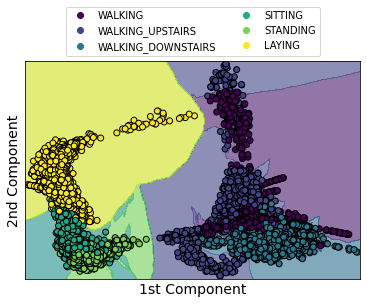

In [174]:
clf_knn_iso = KNN(n_jobs = -1).fit(X_train_iso[:,:2], y_train)
plot_decision_boundaries(X_train_iso[:,:2], y_train, clf_knn_iso, 
                         class_names = activities)
# plt.savefig('KNN_decision_boundaries_isomap.pdf', bbox_inches = 'tight')
plt.show()

In [175]:
cross_val_score(KNN(), X_train_iso[:,:2], y_train, cv = 5).mean()

0.7245705406567794

---

### Multidimensional Scaling

Manifold Learning can be thought of as an attempt to generalize linear frameworks like PCA to be sensitive to non-linear structure in data.

MDS and TSNE do not have the `trasform` method. They can be used only 
for visualization. Check the link below:

https://github.com/scikit-learn/scikit-learn/issues/5361

"It [TSNE, but also MDS] is a transductive learner, like many clustering algorithms:
the model is not really applicable beyond the data points it is 
fed as training."

In [111]:
mds = MDS(n_components = 2, random_state = 5)
X_train_mds = mds.fit_transform(X_train)

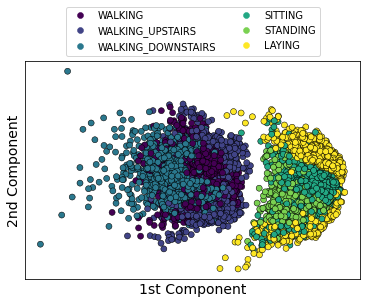

In [164]:
plot_scatter(X_train_mds, y_train, activities)
# plt.savefig('mds_2d.pdf', bbox_inches = 'tight')
plt.show()

In [211]:
mds3 = MDS(n_components = 3, random_state = 5)
X_train_3mds = mds3.fit_transform(X_train)

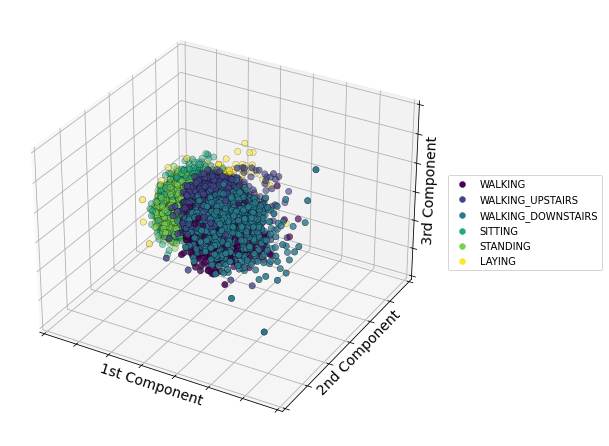

In [212]:
plot_scatter3d(X_train_3mds, y_train, activities)
# plt.savefig('mds_3d.pdf', bbox_inches = 'tight')
plt.show()

In [447]:
# non-metric MDS

mds_nonmetric = MDS(n_components = 2, random_state = 5, n_init = 10, 
            metric = False, n_jobs = 4)
X_train_nonmetric_mds = mds_nonmetric.fit_transform(X_train)

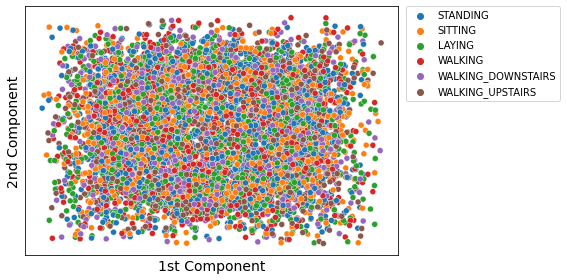

In [448]:
plt.figure(figsize = (8, 4))
plot_scatter(X_train_nonmetric_mds, y_train_mapped)
plt.tight_layout()
plt.show()

WTF?

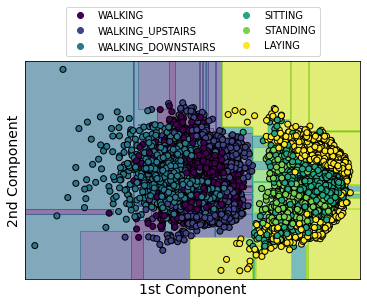

In [117]:
clf_dtc_mds = DTC(random_state = 5).fit(X_train_mds, y_train)
plot_decision_boundaries(X_train_mds, y_train, clf_dtc_mds, 
                         class_names = activities)
# plt.savefig('DTC_decision_boundaries_mds.pdf', bbox_inches = 'tight')
plt.show()

In [118]:
cross_val_score(DTC(), X_train_mds, y_train, cv = 5).mean()

0.6108549415687416

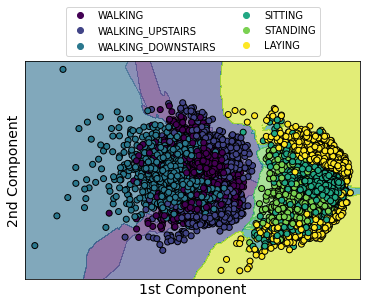

In [120]:
clf_knn_mds = KNN().fit(X_train_mds, y_train)
plot_decision_boundaries(X_train_mds, y_train, clf_knn_mds, 
                         class_names = activities)
# plt.savefig('KNN_decision_boundaries_mds.pdf', bbox_inches = 'tight')
plt.show()

In [122]:
cross_val_score(KNN(), X_train_mds, y_train, cv = 5).mean()

0.6425452628366098

Here, we run a (pseudo-)hyperparameter tuning strategy in order to find the best number of componentes. Since the MDS algorithm is too slow, we decide to perform a random sampling before the search.

In [219]:
X_res_mds, y_res_mds = resample(X_train, y_train,  
                                n_samples = int(0.1 * X_train.shape[0]),
                                stratify = y_train, random_state = 5)

In [224]:
mds_scores = {}
for n in range(2, 15):
    mds2 = MDS(n_components = n, random_state = 5)
    X_res2_mds = mds2.fit_transform(X_res_mds)
    score = cross_val_score(DTC(random_state = 5), X_res2_mds, y_res_mds, 
                           scoring = 'accuracy', cv = 3).mean()    
    mds_scores[n] = score

In [225]:
mds_scores

{2: 0.6721088435374151,
 3: 0.7673469387755102,
 4: 0.7510204081632654,
 5: 0.7360544217687076,
 6: 0.7197278911564625,
 7: 0.7551020408163266,
 8: 0.7210884353741496,
 9: 0.7374149659863946,
 10: 0.7551020408163266,
 11: 0.7659863945578231,
 12: 0.7510204081632653,
 13: 0.7238095238095238,
 14: 0.7292517006802721}

From 3 components, not much seems to change. However, `n_components = 3` appears to be the best solution.

To simulate the analysis performed for PCA and Isomap, we have followed the steps below: 
1. join the train and test set; 
2. compute the latent space with MDS; 
3. separate again the dataset in train and test sets; 
4. train the classifier on the train set; 
5. test the classifier on the test set.

This is done for didactic purposes only, because as noted before, MDS (and t-SNE) is a transductive learner and thus it is not really applicable beyond the training data.

In [123]:
X_full = np.vstack((X_train.values, X_test.values))

In [226]:
mds_full = MDS(n_components = 3, random_state = 5)
X_full_mds = mds_full.fit_transform(X_full)

In [227]:
X_full_train_mds = X_full_mds[:7352]
X_full_test_mds = X_full_mds[7352:]

In [228]:
mds_full = DTC(random_state = 5).fit(X_full_train_mds, y_train)
y_pred_mds = mds_full.predict(X_full_test_mds)

In [229]:
cross_val_score(DTC(random_state = 5), X_full_train_mds, y_train, cv = 5).mean()

0.7101477545470941

In [230]:
print(classification_report(y_test, y_pred_mds, 
                      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.60      0.76      0.67       496
  WALKING_UPSTAIRS       0.78      0.64      0.70       471
WALKING_DOWNSTAIRS       0.50      0.45      0.47       420
           SITTING       0.63      0.61      0.62       491
          STANDING       0.65      0.67      0.66       532
            LAYING       0.99      1.00      0.99       537

          accuracy                           0.70      2947
         macro avg       0.69      0.69      0.69      2947
      weighted avg       0.70      0.70      0.69      2947



In [231]:
mds_full_knn = KNN().fit(X_full_train_mds, y_train)
y_pred_mds_knn = mds_full_knn.predict(X_full_test_mds)

In [232]:
cross_val_score(KNN(), X_full_train_mds, y_train, cv = 5).mean()

0.7561225877162557

In [233]:
print(classification_report(y_test, y_pred_mds_knn, 
                      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.63      0.83      0.72       496
  WALKING_UPSTAIRS       0.85      0.76      0.80       471
WALKING_DOWNSTAIRS       0.60      0.45      0.52       420
           SITTING       0.73      0.59      0.65       491
          STANDING       0.68      0.80      0.74       532
            LAYING       0.99      1.00      1.00       537

          accuracy                           0.75      2947
         macro avg       0.75      0.74      0.74      2947
      weighted avg       0.75      0.75      0.75      2947



---

### t-SNE

In [285]:
# compute t-SNE for different perplexity values

models = []
for k in range(10, 51, 10):
    tsne = TSNE(n_components = 2, learning_rate = 'auto', 
                perplexity = k, init = 'pca', random_state = 5)
    X_train_tsne = tsne.fit_transform(X_train)
    models.append(X_train_tsne)

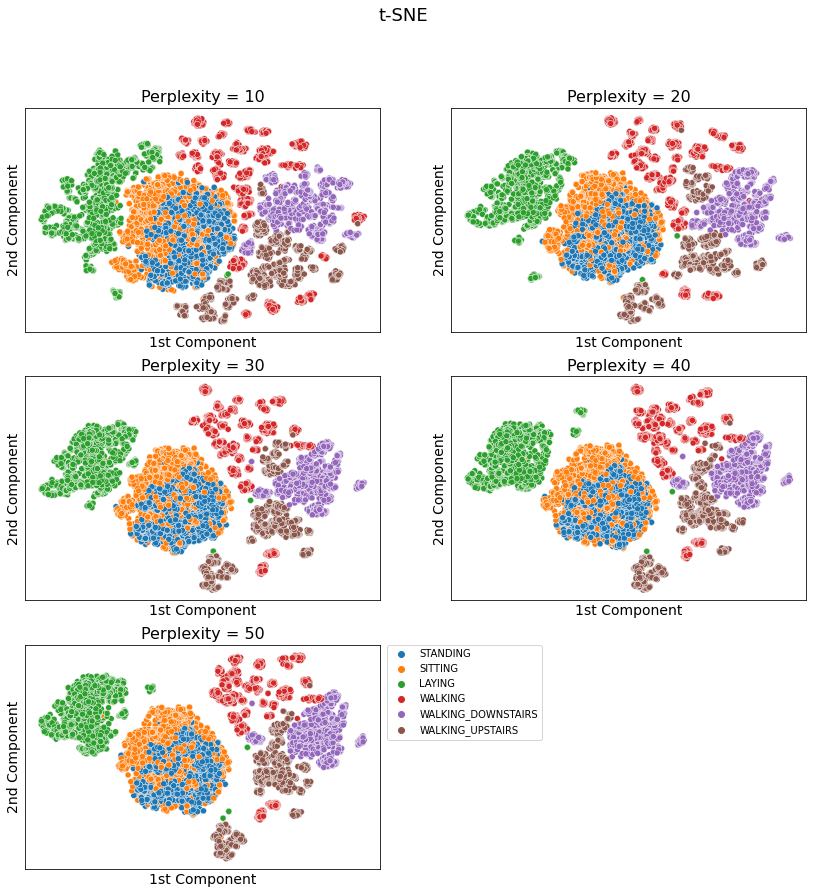

In [411]:
plt.figure(figsize = (14, 14))
plt.suptitle('t-SNE', fontsize = 18)
for i, model in enumerate(models, 1):
    plt.subplot(3, 2, i)
    plot_scatter(model, y_train_mapped)
    plt.title(f'Perplexity = {i*10}', fontsize = 16)
    if i != 5:
        plt.legend([], [], frameon = False)
# plt.tight_layout()        
plt.show()

In [134]:
# perplexity = 50 seems to distinguish better among classes

tsne = TSNE(n_components = 2, learning_rate = 'auto', 
            perplexity = 50, init = 'pca', random_state = 5)
X_train_tsne = tsne.fit_transform(X_train)

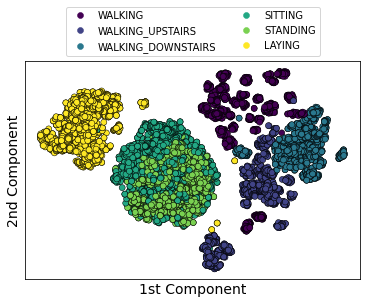

In [180]:
plot_scatter(X_train_tsne, y_train, activities)
# plt.savefig('tsne_2d.pdf', bbox_inches = 'tight')
plt.show()

In [136]:
tsne3 = TSNE(n_components = 3, learning_rate = 'auto', 
            perplexity = 50, init = 'pca', random_state = 5)
X_train_3tsne = tsne3.fit_transform(X_train)

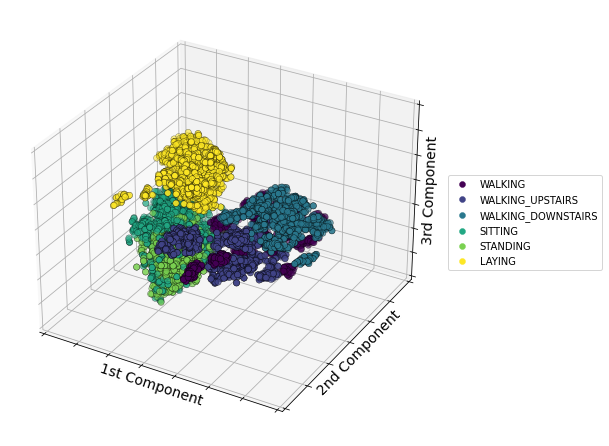

In [181]:
plot_scatter3d(X_train_3tsne, y_train, activities)
# plt.savefig('tsne_3d.pdf', bbox_inches = 'tight')
plt.show()

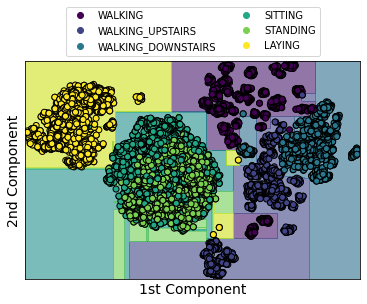

In [138]:
clf_dtc_tsne = DTC(random_state = 5).fit(X_train_tsne, y_train)
plot_decision_boundaries(X_train_tsne, y_train, clf_dtc_tsne, 
                         class_names = activities)
# plt.savefig('DTC_decision_boundaries_tsne.pdf', bbox_inches = 'tight')
plt.show()

In [139]:
cross_val_score(DTC(random_state = 5), X_train_tsne, y_train, cv = 5).mean()

0.8203191868181671

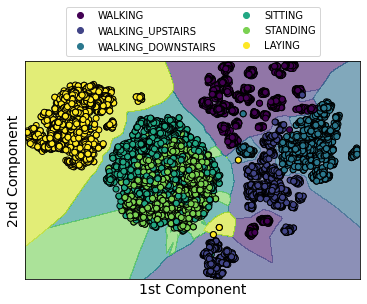

In [140]:
clf_knn_tsne = KNN().fit(X_train_tsne, y_train)
plot_decision_boundaries(X_train_tsne, y_train, clf_knn_tsne, 
                         class_names = activities)
# plt.savefig('KNN_decision_boundaries_tsne.pdf', bbox_inches = 'tight')
plt.show()

In [141]:
cross_val_score(KNN(), X_train_tsne, y_train, cv = 5).mean()

0.89581366741122

this cross-validation score is slightly lower than the one obtained applaying the KNN on the FS dataset.

In [110]:
# Let's try to tune the nunmber of components

tsne_scores = {}
for n in range(2, 10):
    tsne = TSNE(n_components = n, learning_rate = 'auto', perplexity = 50, 
                init = 'pca', random_state = 5)
    X_train2_tsne = tsne.fit_transform(X_train)
    score = cross_val_score(DTC(random_state = 5), X_train2_tsne, y_train, 
                            scoring = 'accuracy', cv = 3, n_jobs = -1).mean()
    tsne_scores[n] = score

ValueError: 'n_components' should be inferior to 4 for the barnes_hut algorithm as it relies on quad-tree or oct-tree.

The maximum number of components the sklearn implementation of t-SNE accepts is 3, because of the Barnes-Hut approximation. Probably, this can be bypassed by setting `method = 'exact'`, however the algorithm is too low.

From the cross-validation scores just computed, we note that 2 or 3 components make no difference.

In [112]:
tsne_scores

{2: 0.8182705934270893, 3: 0.8177342581259349}

The same considerations made for MDS apply to t-SNE. Therefore, we conduct the same analysis.

In [124]:
tsne = TSNE(n_components = 2, learning_rate = 'auto', 
            perplexity = 50, init = 'pca', random_state = 5)
X_full_tsne = tsne.fit_transform(X_full)

In [125]:
X_full_train = X_full_tsne[:7352]
X_full_test = X_full_tsne[7352:]

In [126]:
tsne_full = DTC(random_state = 5).fit(X_full_train, y_train)
y_pred_tsne = tsne_full.predict(X_full_test)

In [130]:
cross_val_score(DTC(random_state = 5), X_full_train, y_train, cv = 5).mean()

0.8525555755952959

In [128]:
print(classification_report(y_test, y_pred_tsne, 
                      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.89      1.00      0.94       496
  WALKING_UPSTAIRS       0.88      0.80      0.84       471
WALKING_DOWNSTAIRS       0.86      0.83      0.84       420
           SITTING       0.81      0.77      0.79       491
          STANDING       0.80      0.85      0.83       532
            LAYING       1.00      0.99      1.00       537

          accuracy                           0.87      2947
         macro avg       0.87      0.87      0.87      2947
      weighted avg       0.87      0.87      0.87      2947



In [131]:
tsne_full_knn = KNN().fit(X_full_train, y_train)
y_pred_tsne_knn = tsne_full_knn.predict(X_full_test)

In [132]:
cross_val_score(KNN(), X_full_train, y_train, cv = 5).mean()

0.8867029231815092

In [133]:
print(classification_report(y_test, y_pred_tsne_knn, 
                      target_names = activities.values()))

                    precision    recall  f1-score   support

           WALKING       0.99      1.00      0.99       496
  WALKING_UPSTAIRS       0.93      0.91      0.92       471
WALKING_DOWNSTAIRS       0.90      0.93      0.91       420
           SITTING       0.83      0.76      0.79       491
          STANDING       0.80      0.86      0.83       532
            LAYING       1.00      1.00      1.00       537

          accuracy                           0.91      2947
         macro avg       0.91      0.91      0.91      2947
      weighted avg       0.91      0.91      0.91      2947



As we can see, this approach produces even better results than those obtained on the dataset with all the features. However, we must again remember that t-SNE is a transductive algorithm and can only be applied on the data we use to train the model. Moreover, the procedure adopted here suffer from overfitting since we compute the embedded features considering the whole dataset.

### Comparison among dimensionality reduction approaches

In [234]:
fe_techniques = {'PCA': [78,87], 'Isomap': [81,84], 'MDS': [70,75], 't-SNE': [87,91]}
fe_techniques = pd.DataFrame(fe_techniques, index = ['Decision\nTree', 'K-Nearest\nNeighbors'])

In [235]:
optimal_components = [24, 7, 3, 2]

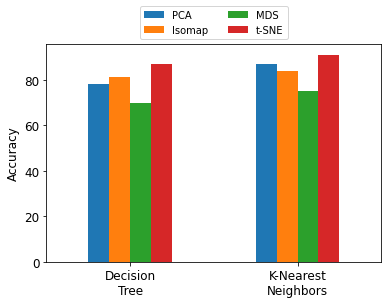

In [245]:
fig, ax = plt.subplots(figsize = (6,4))
fe_techniques.plot.bar(ax = ax, rot = 0)
ax.legend(loc = 'lower center', ncol = 2, fontsize = 'small', 
              bbox_to_anchor = (0, 1, 1, 1))
ax.set_ylabel('Accuracy')
# plt.savefig('fe_comparisons.pdf', bbox_inches = 'tight')
plt.show()

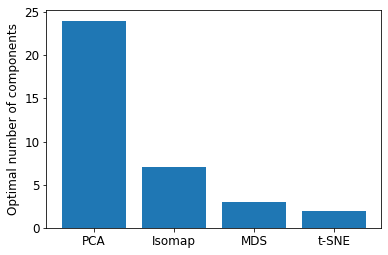

In [246]:
plt.figure(figsize = (6,4))
xticks = range(1,5)
plt.bar(xticks, optimal_components)
plt.ylabel('Optimal number of components')
plt.xticks(xticks, fe_techniques.columns)
# plt.savefig('fe_n_components.pdf', bbox_inches = 'tight')
plt.show()